# <center> Galaxy Colorization Project using Pix2Pix GAN
    
---

## PyTorch Implementation
* We shall use PyTorch (another framework to build neural nets) for this project.
* You can also try implementing the same project using Tensorflow and Keras.
* We shall mostly follow the [Pix2Pix Paper](https://arxiv.org/pdf/1611.07004) to complete this project.

## 1. Add the Dataset 
* We will use Images of Galaxies from the `Galaxy Zoo Project` [dataset](https://www.kaggle.com/competitions/galaxy-zoo-the-galaxy-challenge)
* Add this Dataset to your Notebook.

**About the Dataset**
* It's a citizen science project that started in 2007. 
* The goal of the project is to classify galaxies based on their shapes.
* This helps astronomers understand galaxy formation and evolution. 
* You can participate in it as well by clicking [here](https://www.zooniverse.org/projects/zookeeper/galaxy-zoo/classify).
* In our case, we shall use the same dataset for the `Coloring Galaxies Project`.

## 2. Unzip the Dataset 

In [1]:
# Extract the contents of a ZIP file to a specified directory which will be created if doesn't exist already
!unzip "/kaggle/input/galaxy-zoo-the-galaxy-challenge/images_training_rev1.zip" -d "/kaggle/working/Galaxies"

Archive:  /kaggle/input/galaxy-zoo-the-galaxy-challenge/images_training_rev1.zip
replace /kaggle/working/Galaxies/images_training_rev1/100008.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: ^C


## 3. Import Libraries

In [21]:
# Importing various Python libraries and modules used for different tasks

# For interacting with the operating system, such as file and directory operations
import os

# For finding all the pathnames matching a specified pattern
import glob

# Useful for measuring execution time
import time

# For array handling 
import numpy as np

# For handling Image files
from PIL import Image

# Useful for indicating the progress of long-running tasks (like training)
from tqdm.notebook import tqdm

# For generating visualizations
import matplotlib.pyplot as plt

# Helps in convert images between RGB and LAB color spaces
from skimage.color import rgb2lab, lab2rgb

# PyTorch related imports for building and training neural networks
import torch
from torch import nn, optim  # `nn` is for creating neural network layers and models; `optim` is for optimization algorithms.
from torchvision import transforms  # Provides various image transformation operations for data augmentation and preprocessing.
from torch.utils.data import Dataset, DataLoader  # `Dataset` is an abstract class representing a dataset; `DataLoader` provides an iterable over the dataset.

# Suppressing warnings to avoid cluttering output with warning messages.
import warnings
warnings.filterwarnings('ignore')

## 4. Visualizing the Images in the Dataset

In [22]:
# If a CUDA-compatible GPU is available, use it; otherwise, use the CPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [23]:
# Path pattern for locating all jpg image files in the directory
dataset_path = '/kaggle/working/Galaxies/images_training_rev1/*.jpg'

# List of all image file paths that match the dataset path pattern 
paths = glob.glob(dataset_path)

In [24]:
# Check total samples 
len(paths)

61578

In [25]:
# Subset of total images
TOTAL_SAMPLES = 20000
TRAIN_SAMPLES_PERCENTAGE = 0.9
N_TRAINING_SAMPLES = int(TOTAL_SAMPLES*TRAIN_SAMPLES_PERCENTAGE)

In [26]:
# Randomly select a subset of 20K image file paths from the full list (61K+) of paths
np.random.seed(123)
paths_subset = np.random.choice(paths, TOTAL_SAMPLES, replace=False) # replace=False ensures that no duplicate paths

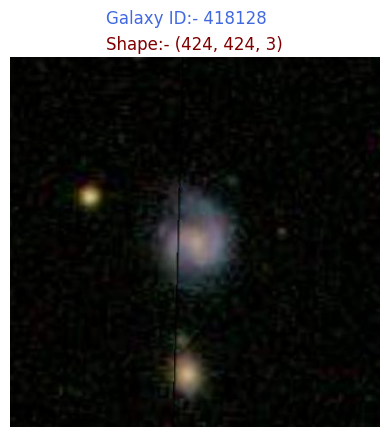

In [27]:
# Get a random image to visualize from the paths
random_path = np.random.choice(paths_subset)                   # Randomly choose an image path 
image_id = random_path.split("/")[-1][:-4]                     # Last element of split is ID.jpg, slice it to get ID 
image = Image.open(random_path)                                # Open the image
plt.imshow(image)
plt.axis('off')
plt.suptitle(f'Galaxy ID:- {image_id}', color='royalblue')
plt.title(f'Shape:- {image.size + (3,)}', color='maroon')
plt.show()

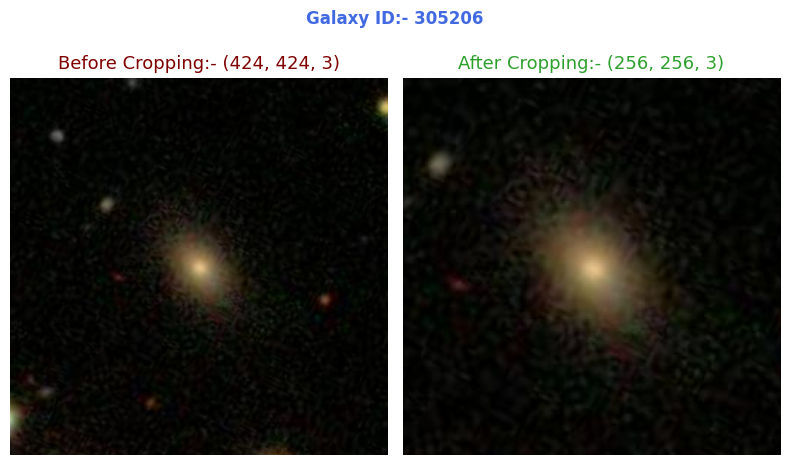

In [28]:
# Define the Crop Size
SIZE = 256

# Get a random image
random_path = np.random.choice(paths_subset)                    
image_id = random_path.split("/")[-1][:-4]                     
image = Image.open(random_path)                                

# Apply center crop to images as that's the region of interest
cc_transform = transforms.Compose([transforms.CenterCrop(SIZE)])

# Side by Side Comparison using subplot 
plt.figure(figsize=(8, 5))                                                           # Set Figure Size
plt.suptitle(f'Galaxy ID:- {image_id}', color='royalblue', weight='bold')            # Set super title

# Loop through images, titles, and colors for plotting
for i, (img, title, color) in enumerate(zip((image, cc_transform(image)),            # Zip images, titles, colors
                                            ('Before Cropping', 'After Cropping'),
                                            ('maroon', 'tab:green'))):
    # Subplot - Side by Side Plots with custom image, title and title_colors
    plt.subplot(1, 2, i+1)        
    plt.imshow(img)
    plt.axis('off')
    plt.title(f'{title}:- {img.size + (3, )}', color=color, fontsize=13)

# Adjust the subplots
plt.tight_layout()
plt.show()

## 5. DataLoader for Training and Testing Set

#### LAB Color Space over RGB for Image Colorization Tasks

* LAB separates luminance/lightness (L*) from color information (a* and b*).
* This allows the GAN to focus on colorization (a* and b*) independent of the luminance (L*).
* This eventually simplifies the learning process for GAN and improves the results.
* Also, LAB can help minimize color artifacts and inconsistencies by providing a more consistent color representation.
* This avoids the issues that arise from directly manipulating the RGB channels which may lead to unrealistic color blending and distortions.

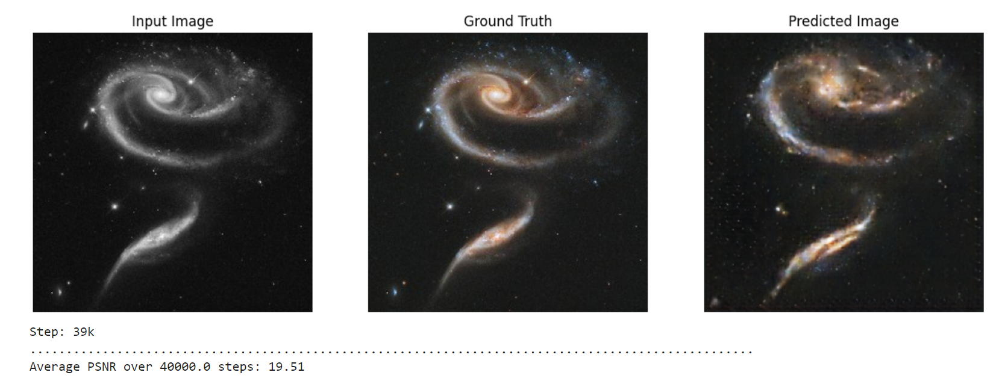

* L* ranges from 0 (complete absence of lightness) to 100 (maximum lightness)
* a* ranges from -a (Green) to a (Red)
* b* ranges from -b (Blue) to b (Yellow)
* Note that we will use skimage's rgb2lab and lab2rgb conversions where L ranges from 0 to 100, and (a*, b*) ranges from -128 to 127

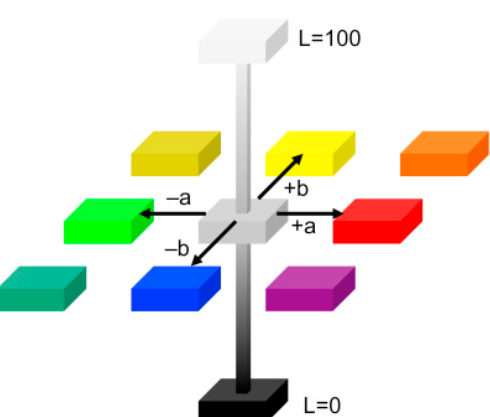

In [29]:
# Set a random seed to ensure that the random operations are the same each time the code runs
np.random.seed(123)

# Create a shuffled list of indices from 0 to 19,999 to randomly shuffle the paths
rand_idxs = np.random.permutation(TOTAL_SAMPLES)

# Indices for Splitting Images into train and val set
train_idxs = rand_idxs[:N_TRAINING_SAMPLES] # First 18K indices are for the train set
val_idxs = rand_idxs[N_TRAINING_SAMPLES:] # Remaining 2K for the val set

# Use these indices to get the file paths for the training and validation sets
train_paths = paths_subset[train_idxs]
val_paths = paths_subset[val_idxs]

# Print the number of images in each subset to verify the split
print("Number of training images:", len(train_paths))
print("Number of validation images:", len(val_paths))

Number of training images: 18000
Number of validation images: 2000


In [30]:
class ColorizationDataset(Dataset):
    """
    A custom Dataset class for loading and processing images for colorization tasks.

    This class takes in a list of image file paths and a crop size. It loads images, converts them to the L*a*b color space,
    and normalizes them to be used for training a colorization model.

    Attributes:
        paths (list of str): List of file paths to the images.
        size (int or tuple): Size to which images will be cropped. If int, it is assumed to be a square crop.
    """

    def __init__(self, paths, crop_size):
        """
        Initializes the dataset with image paths and crop size.

        Args:
            paths (list of str): List of file paths to the images.
            crop_size (int or tuple): The size to crop the images to. If an int, it crops to a square of size `crop_size`.
        """
        self.paths = paths
        self.size = crop_size

    def __getitem__(self, idx):
        """
        Retrieves and processes an image at the specified index.

        Args:
            idx (int): Index of the image to retrieve.

        Returns:
            dict: A dictionary containing:
                - 'L' (torch.Tensor): Normalized luminance channel (L) of the image.
                - 'ab' (torch.Tensor): Normalized color channels (a and b) of the image.
        """
        # Open and convert the image to RGB format
        img = Image.open(self.paths[idx]).convert("RGB")
        
        # Crop the image to the specified size
        img = transforms.Compose([transforms.CenterCrop(self.size)])(img)
        
        # Convert the image to a NumPy array
        img = np.array(img)
        
        # Convert the RGB image to L*a*b color space
        img_lab = rgb2lab(img).astype("float32")
        
        # Convert the image to a PyTorch tensor
        img_lab = transforms.ToTensor()(img_lab)
        
        # Normalize the L channel (luminance) to be between -1 and 1
        # Original range: [0, 100], Target range: [-1, 1]
        L = img_lab[0, ...] / 50. - 1.  # 50 is half of 100, so this scales [0, 100] to [-1, 1]
        # output:- (batch_size, H, W)
        
        # Normalize the a and b channels (color information) to be between -1 and 1
        # Original range: [-128, 127], Target range: [-1, 1]
        ab = (img_lab[1:3, ...] + 128.) / 255. * 2. - 1.  # Offset by 128, scale to [0, 1], then map to [-1, 1]
        # output:- (batch_size, channels, H, W)

        # Return the processed image as a dictionary
        return {'L': L.unsqueeze(0), 'ab': ab}

    def __len__(self):
        """
        Returns the total number of images in the dataset.

        Returns:
            int: The number of images in the dataset.
        """
        return len(self.paths)

In [31]:
def make_dataloaders(batch_size=16, n_workers=4, pin_memory=True, **kwargs):
    """
    Creates DataLoader instances for training and validation datasets.

    This function sets up the DataLoader to manage batching and loading of the dataset. It helps in efficiently
    fetching batches of images for training or validation.

    Args:
        batch_size (int): The number of images to include in each batch.
        n_workers (int): The number of worker processes to use for data loading.
        pin_memory (bool): Whether to pin memory in GPU to speed up data transfer.
        **kwargs: Additional keyword arguments passed to the ColorizationDataset constructor.

    Returns:
        DataLoader: A DataLoader instance that provides batches of images.
    """
    # Create an instance of ColorizationDataset with the provided arguments
    dataset = ColorizationDataset(**kwargs)
    
    # Create and return a DataLoader for the dataset
    dataloader = DataLoader(dataset, batch_size=batch_size, num_workers=n_workers, pin_memory=pin_memory)
    
    return dataloader

In [32]:
# Create a DataLoader for the training dataset
train_dl = make_dataloaders(paths=train_paths, crop_size=SIZE)

# Create a DataLoader for the validation dataset
val_dl = make_dataloaders(paths=val_paths, crop_size=SIZE)

In [33]:
# Analyze the Example Batch
example_batch = next(iter(train_dl))
L_batch, ab_batch = example_batch['L'], example_batch['ab']

# Check the shapes (Batch Size, Channels, Height, Width)
print(f'Shape of L Batch:- {L_batch.shape}') 
print(f'Shape of ab Batch:- {ab_batch.shape}')

Shape of L Batch:- torch.Size([16, 1, 256, 256])
Shape of ab Batch:- torch.Size([16, 2, 256, 256])


In [34]:
# Set counter for visualizing batch in next cell
id_ = 0

In [35]:
ab_batch[0].shape

torch.Size([2, 256, 256])

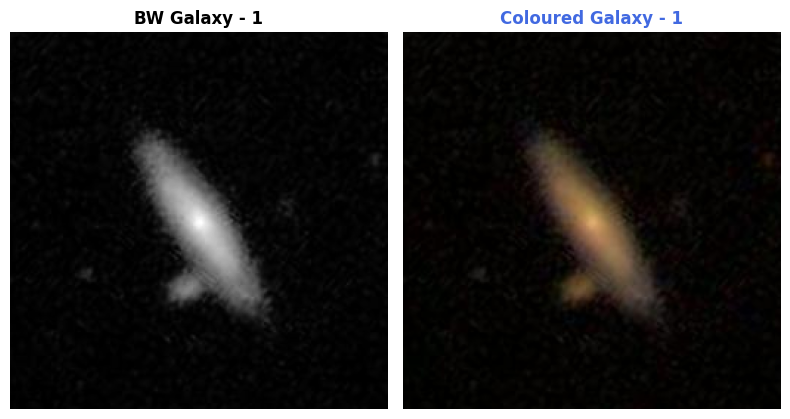

In [36]:
# Combine L and ab channels to form L*a*b* image
L_np = L_batch[id_].numpy().transpose(1, 2, 0)  # Shape: (SIZE, SIZE, 1)
ab_np = ab_batch[id_].numpy().transpose(1, 2, 0)  # Shape: (SIZE, SIZE, 2)

# Normalize L channel to range [0, 100]
L_np = (L_np + 1) * 50.0

# Normalize ab channels to range [-128, 127]
ab_np = ((ab_np+1)*255/2)-128

# Stack L and ab channels to create an L*a*b* image
lab_img = np.stack([L_np[:, :, 0], ab_np[:, :, 0], ab_np[:, :, 1]], axis=-1)  # Shape: (SIZE, SIZE, 3)

# Convert L*a*b* image to RGB
rgb_img = lab2rgb(lab_img)

# Create tuples for ploting images with respective titles
imgs = (L_np, rgb_img)
titles = ('BW Galaxy', 'Coloured Galaxy')

# Plot side by side images for bw image and coloured image
plt.figure(figsize=(8, 5))                  
for i in range(2):                                                                      # i = 0, 1
    plt.subplot(1, 2, i+1)                                                              # plot on axis = 1, 2
    plt.imshow(imgs[i], cmap='gray')                                                    # display = L, rgb
    plt.title(f'{titles[i]} - {id_+1}',                                                 # Title, color, weight
              color = 'royalblue' if titles[i] == 'Coloured Galaxy' else 'black', 
              weight='bold')
    plt.axis('off')                                                                     # Axis off 
plt.tight_layout()                                                                      # Adjust layout of subplot
plt.show()                                                                              # Display subplot

# Update the counter if needed to not run into error after exhausting all 16 indices
if id_ < 15:    
    id_ += 1
else:
    id_ = 0

## 6. UNET for Generator


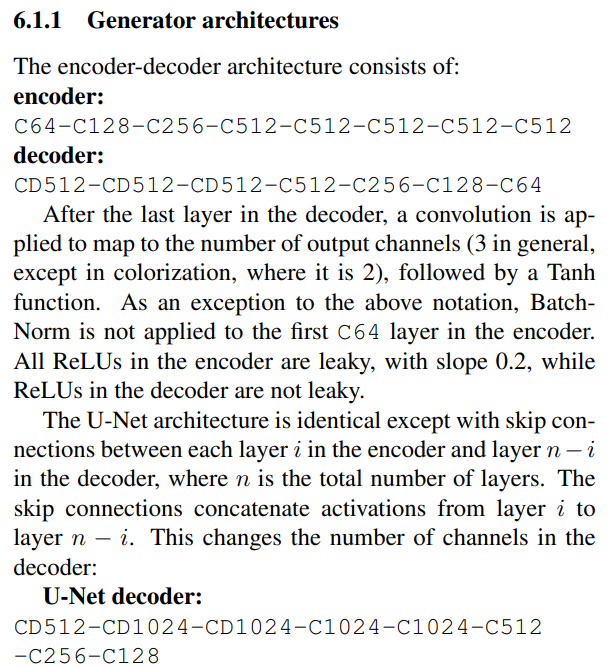

In [58]:
class UnetBlock(nn.Module): 
    """
    A single block of the U-Net model. U-Net is used for image processing tasks, 
    especially for segmenting and colorizing images.
    """
    def __init__(self, nf, ni, submodule=None, input_c=None, dropout=False,
                 innermost=False, outermost=False):
        """
        Initialize the U-Net block.
        
        Parameters
        ----------
        nf : int
            Number of filters in the output.
        ni : int
            Number of filters in the input.
        submodule : nn.Module, optional
            Another U-Net block that this block will use.
        input_c : int, optional
            Number of input channels. Defaults to nf.
        dropout : bool, optional
            Whether to apply dropout (a way to prevent overfitting).
        innermost : bool, optional
            If True, this is the innermost block of the U-Net.
        outermost : bool, optional
            If True, this is the outermost block of the U-Net.
        """
        super().__init__()
        self.outermost = outermost  # Mark this block as the outermost one

        if input_c is None:
            input_c = nf  # Set the input channels to the number of output filters

        # Define the layers for this block
        downconv = nn.Conv2d(input_c, ni, kernel_size=4, stride=2, padding=1, bias=False)
        downrelu = nn.LeakyReLU(0.2, True)
        downnorm = nn.BatchNorm2d(ni)
        uprelu = nn.ReLU(True)
        upnorm = nn.BatchNorm2d(nf)

        if outermost:
            # If this is the outermost block, it does not need concatenation
            upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=4, stride=2, padding=1)
            down = [downconv]  # Only downconv for outermost block
            up = [uprelu, upconv, nn.Tanh()]  # Upconv, relu, and tanh for outermost block
            model = down + [submodule] + up  # Combine everything to make the full block
        elif innermost:
            # If this is the innermost block, it does not have a submodule
            upconv = nn.ConvTranspose2d(ni, nf, kernel_size=4, stride=2, padding=1, bias=False)
            down = [downrelu, downconv]  # Relu and downconv for innermost block
            up = [uprelu, upconv, upnorm]  # Upconv, relu, and norm for innermost block
            model = down + up  # Combine layers for the innermost block
        else:
            # Regular block with both down and up layers
            upconv = nn.ConvTranspose2d(ni * 2, nf, kernel_size=4, stride=2, padding=1, bias=False)
            down = [downrelu, downconv, downnorm]  # Relu, downconv, and norm for regular block
            up = [uprelu, upconv, upnorm]  # Relu, upconv, and norm for regular block
            if dropout:
                up += [nn.Dropout(0.5)]  # Add dropout if needed
            model = down + [submodule] + up  # Combine layers and submodule

        self.model = nn.Sequential(*model)  # Create a sequential model with the defined layers

    def forward(self, x):
        """
        Forward pass through the U-Net block.
        
        Parameters
        ----------
        x : torch.Tensor
            The input image tensor.
        
        Returns
        -------
        torch.Tensor
            The output image tensor.
        """
        if self.outermost:
            return self.model(x)  # For the outermost block, just return the model output
        else:
            return torch.cat([x, self.model(x)], 1)  # For other blocks, concatenate input and output (skip connection)

In [59]:
class Unet(nn.Module):
    """
    U-Net model for tasks like image segmentation and colorization.
    """
    def __init__(self, input_c=1, output_c=2, n_down=8, num_filters=64):
        """
        Initialize the U-Net model.
        
        Parameters
        ----------
        input_c : int
            Number of input channels (e.g., 1 for grayscale).
        output_c : int
            Number of output channels (e.g., 2 for color).
        n_down : int
            Number of downsampling steps.
        num_filters : int
            Number of filters in the first layer.
        """
        super().__init__()
        
        # Start with the innermost block of the U-Net
        unet_block = UnetBlock(num_filters * 8, num_filters * 8, innermost=True)
        
        # Add more blocks to the U-Net
        for _ in range(n_down - 5):
            unet_block = UnetBlock(num_filters * 8, num_filters * 8, submodule=unet_block, dropout=True)
        
        # Create the rest of the blocks
        out_filters = num_filters * 8
        for _ in range(3):
            unet_block = UnetBlock(out_filters // 2, out_filters, submodule=unet_block)
            out_filters //= 2
        
        # Create the outermost block
        self.model = UnetBlock(output_c, out_filters, input_c=input_c, submodule=unet_block, outermost=True)

    def forward(self, x):
        """
        Forward pass through the U-Net model.
        
        Parameters
        ----------
        x : torch.Tensor
            The input image tensor.
        
        Returns
        -------
        torch.Tensor
            The output image tensor.
        """
        return self.model(x)

In [42]:
class EncoderBlock(nn.Module):
    """An encoder block for the U-Net generator.

    Args:
        in_channels (int): Number of input channels.
        out_channels (int): Number of output channels.
        use_batchnorm (bool): Whether to use batch normalization.
    """
    def __init__(self, in_channels, out_channels, use_batchnorm=True):
        super(EncoderBlock, self).__init__()  # Initialize the parent class
        layers = [
            nn.LeakyReLU(0.2, inplace=True),  # Leaky ReLU activation with negative slope of 0.2
            nn.Conv2d(in_channels, out_channels, kernel_size=4, stride=2, padding=1)  # 2D convolution layer for downsampling
        ]
        if use_batchnorm:  # Check if batch normalization should be applied
            layers.append(nn.BatchNorm2d(out_channels))  # Add batch normalization layer
        self.block = nn.Sequential(*layers)  # Create a sequential block of layers

    def forward(self, x):
        """Forward pass through the encoder block."""
        return self.block(x)  # Pass input through the block

class DecoderBlock(nn.Module):
    """A decoder block for the U-Net generator.

    Args:
        in_channels (int): Number of input channels.
        out_channels (int): Number of output channels.
        use_dropout (bool): Whether to apply dropout.
    """
    def __init__(self, in_channels, out_channels, use_dropout=False):
        super(DecoderBlock, self).__init__()  # Initialize the parent class
        layers = [
            nn.ReLU(inplace=True),  # ReLU activation for non-linearity
            nn.ConvTranspose2d(in_channels, out_channels, kernel_size=4, stride=2, padding=1),  # Transposed convolution for upsampling
            nn.BatchNorm2d(out_channels)  # Batch normalization layer
        ]
        if use_dropout:  # Check if dropout should be applied
            layers.append(nn.Dropout(0.5))  # Add dropout layer with 50% rate
        self.block = nn.Sequential(*layers)  # Create a sequential block of layers

    def forward(self, x):
        """Forward pass through the decoder block."""
        return self.block(x)  # Pass input through the block

class UNetGenerator(nn.Module):
    """U-Net generator architecture.

    Args:
        input_nc (int): Number of input channels.
        output_nc (int): Number of output channels.
        ngf (int): Number of filters in the first layer.
    """ 
    def __init__(self, input_nc, output_nc, ngf):
        super(UNetGenerator, self).__init__()  # Initialize the parent class
        
        # Encoder layers
        self.e1 = nn.Conv2d(input_nc, ngf, kernel_size=4, stride=2, padding=1)  # Initial convolution layer
        self.e2 = EncoderBlock(ngf, ngf * 2)  # First encoder block
        self.e3 = EncoderBlock(ngf * 2, ngf * 4)  # Second encoder block
        self.e4 = EncoderBlock(ngf * 4, ngf * 8)  # Third encoder block
        self.e5 = EncoderBlock(ngf * 8, ngf * 8)  # Fourth encoder block
        self.e6 = EncoderBlock(ngf * 8, ngf * 8)  # Fifth encoder block
        self.e7 = EncoderBlock(ngf * 8, ngf * 8)  # Sixth encoder block
        self.e8 = EncoderBlock(ngf * 8, ngf * 8, use_batchnorm=False)  # Last encoder block without batch normalization
        
        # Decoder layers
        self.d1 = DecoderBlock(ngf * 8, ngf * 8, use_dropout=True)  # First decoder block with dropout
        self.d2 = DecoderBlock(ngf * 8 * 2, ngf * 8, use_dropout=True)  # Second decoder block with concatenated skip connection
        self.d3 = DecoderBlock(ngf * 8 * 2, ngf * 8, use_dropout=True)  # Third decoder block with concatenated skip connection
        self.d4 = DecoderBlock(ngf * 8 * 2, ngf * 8)  # Fourth decoder block with concatenated skip connection
        self.d5 = DecoderBlock(ngf * 8 * 2, ngf * 4)  # Fifth decoder block with concatenated skip connection
        self.d6 = DecoderBlock(ngf * 4 * 2, ngf * 2)  # Sixth decoder block with concatenated skip connection
        self.d7 = DecoderBlock(ngf * 2 * 2, ngf)  # Seventh decoder block with concatenated skip connection
        self.d8 = nn.Sequential(  # Final output layer
            nn.ReLU(inplace=True),  # ReLU activation for output
            nn.ConvTranspose2d(ngf * 2, output_nc, kernel_size=4, stride=2, padding=1),  # Transposed convolution to produce output
            nn.Tanh()  # Tanh activation function for normalized output
        )

    def forward(self, x):
        """Forward pass through the entire U-Net generator."""
        # Encoder pass
        e1 = self.e1(x)  # Apply the first encoder layer
        e2 = self.e2(e1)  # Apply the second encoder layer
        e3 = self.e3(e2)  # Apply the third encoder layer
        e4 = self.e4(e3)  # Apply the fourth encoder layer
        e5 = self.e5(e4)  # Apply the fifth encoder layer
        e6 = self.e6(e5)  # Apply the sixth encoder layer
        e7 = self.e7(e6)  # Apply the seventh encoder layer 
        e8 = self.e8(e7)  # Apply the eighth encoder layer
        
        # Decoder pass with skip connections
        d1 = self.d1(e8)  # Apply the first decoder layer
        d1 = torch.cat([d1, e7], 1)  # Concatenate with the skip connection from encoder
        d2 = self.d2(d1)  # Apply the second decoder layer
        d2 = torch.cat([d2, e6], 1)  # Concatenate with the skip connection from encoder
        d3 = self.d3(d2)  # Apply the third decoder layer
        d3 = torch.cat([d3, e5], 1)  # Concatenate with the skip connection from encoder
        d4 = self.d4(d3)  # Apply the fourth decoder layer
        d4 = torch.cat([d4, e4], 1)  # Concatenate with the skip connection from encoder
        d5 = self.d5(d4)  # Apply the fifth decoder layer
        d5 = torch.cat([d5, e3], 1)  # Concatenate with the skip connection from encoder
        d6 = self.d6(d5)  # Apply the sixth decoder layer
        d6 = torch.cat([d6, e2], 1)  # Concatenate with the skip connection from encoder
        d7 = self.d7(d6)  # Apply the seventh decoder layer
        d7 = torch.cat([d7, e1], 1)  # Concatenate with the skip connection from encoder
        d8 = self.d8(d7)  # Apply the final output layer
        
        return d8  # Return the output of the generator

In [43]:
input_nc = 1 # L
output_nc = 2 # AB
ngf = 64      # Filters in the first layer of UNET
netG = UNetGenerator(input_nc, output_nc, ngf)(torch.randn(16, 1, 256, 256))
netG.shape

torch.Size([16, 2, 256, 256])

In [45]:
UNetGenerator(input_nc, output_nc, ngf)

UNetGenerator(
  (e1): Conv2d(1, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (e2): EncoderBlock(
    (block): Sequential(
      (0): LeakyReLU(negative_slope=0.2, inplace=True)
      (1): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
  )
  (e3): EncoderBlock(
    (block): Sequential(
      (0): LeakyReLU(negative_slope=0.2, inplace=True)
      (1): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (2): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
  )
  (e4): EncoderBlock(
    (block): Sequential(
      (0): LeakyReLU(negative_slope=0.2, inplace=True)
      (1): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (2): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    )
  )
  (e5): EncoderBlock(
    (block): Sequential(
      (0): LeakyR

In [60]:
# Create an instance of the U-Net model to test it
gen = Unet(input_c=1, output_c=2, n_down=8, num_filters=64) # Create dummy UNET for Generator
dummy_input = torch.randn(16, 1, 256, 256)                  # Dummy Inputs to check output
out = gen(dummy_input)                                      # Get the output from Generator
print(gen)                                                  # Print how UNET looks like
print(out.shape)                                            # Get the shape of the output

Unet(
  (model): UnetBlock(
    (model): Sequential(
      (0): Conv2d(1, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): UnetBlock(
        (model): Sequential(
          (0): LeakyReLU(negative_slope=0.2, inplace=True)
          (1): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
          (2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (3): UnetBlock(
            (model): Sequential(
              (0): LeakyReLU(negative_slope=0.2, inplace=True)
              (1): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
              (2): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
              (3): UnetBlock(
                (model): Sequential(
                  (0): LeakyReLU(negative_slope=0.2, inplace=True)
                  (1): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
 

## 7. PatchGAN (70x70) for Discriminator

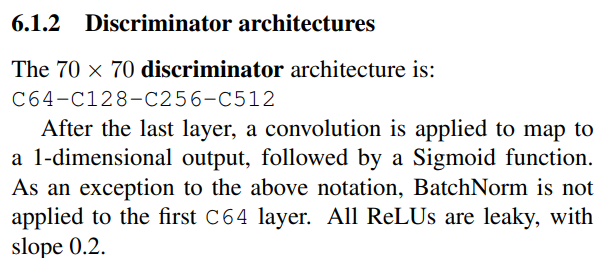

In [ ]:
class PatchDiscriminator(nn.Module):
    def __init__(self, input_c, num_filters=64, n_down=3):
        """
        Initializes the PatchDiscriminator model.

        Parameters:
        - input_c (int): Number of input channels in the image.
        - num_filters (int): Number of filters in the first convolutional layer.
        - n_down (int): Number of downsampling steps in the model.
        """
        super().__init__()
        
        # Create a list to hold all the layers of the model
        model = [self.get_layers(input_c, num_filters, norm=False)]
        
        # Add layers for downsampling
        # Each layer will double the number of filters and reduce the image size
        model += [self.get_layers(num_filters * 2 ** i, num_filters * 2 ** (i + 1), s=1 if i == (n_down-1) else 2) 
                  for i in range(n_down)]
        # Add the final layer to output a single value for each patch
        # No normalization or activation for the last layer
        model += [self.get_layers(num_filters * 2 ** n_down, 1, s=1, norm=False, act=False)]
        
        # Combine all layers into a single model
        self.model = nn.Sequential(*model)
    
    def get_layers(self, ni, nf, k=4, s=2, p=1, norm=True, act=True):
        """
        Creates a block of layers for the discriminator.

        Parameters:
        - ni (int): Number of input channels.
        - nf (int): Number of output channels.
        - k (int): Kernel size for the convolution.
        - s (int): Stride for the convolution.
        - p (int): Padding for the convolution.
        - norm (bool): Whether to include batch normalization.
        - act (bool): Whether to include LeakyReLU activation.

        Returns:
        - nn.Sequential: A sequential block of layers.
        """
        # Start with a convolutional layer
        layers = [nn.Conv2d(ni, nf, k, s, p, bias=not norm)]
        
        # Optionally add batch normalization
        if norm: 
            layers += [nn.BatchNorm2d(nf)]
        
        # Optionally add LeakyReLU activation
        if act: 
            layers += [nn.LeakyReLU(0.2, True)]
        
        # Return the block of layers as a sequential model
        return nn.Sequential(*layers)
    
    def forward(self, x):
        """
        Passes the input through the model.

        Parameters:
        - x (Tensor): Input image tensor.

        Returns:
        - Tensor: Output tensor after passing through the model.
        """
        return self.model(x)

In [152]:
# Instance of PatchGAN discriminator to test it
discriminator = PatchDiscriminator(input_c=3, n_down=3, num_filters=64)          # Dummy Discriminator
dummy_input = torch.randn(16, 3, 256, 256)                                       # Dummy Input
out = discriminator(dummy_input)                                                 # Discriminator's output
print(discriminator)                                                             # Check how Discriminator looks like
print(out.shape)                                                                 # Output shape of discriminator

PatchDiscriminator(
  (model): Sequential(
    (0): Sequential(
      (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
      (1): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (1): Sequential(
      (0): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (2): Sequential(
      (0): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (3): Sequential(
      (0): Conv2d(256, 512, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (

## 8. GAN Loss Function

In [213]:
class GANLoss(nn.Module):
    def __init__(self, gan_mode='vanilla', real_label=1.0, fake_label=0.0):
        """
        Initializes the GANLoss class.
        
        Parameters
        ----------
        gan_mode : str
            Specifies the type of GAN loss to use. Options are 'vanilla' (binary cross-entropy) 
            and 'lsgan' (least-squares). You can add more modes like 'wgan-gp' if needed.
        real_label : float
            The value used for the real labels. Default is 1.0.
        fake_label : float
            The value used for the fake labels. Default is 0.0.
        """
        super().__init__()
        
        # Register buffers for real and fake labels. Buffers are tensors that are not updated by optimization but are saved and loaded.
        self.register_buffer('real_label', torch.tensor(real_label))
        self.register_buffer('fake_label', torch.tensor(fake_label))
        
        # Choose the loss function based on the specified GAN mode
        if gan_mode == 'vanilla':
            # Vanilla GAN uses binary cross-entropy loss
            self.loss = nn.BCEWithLogitsLoss()
        elif gan_mode == 'lsgan':
            # Least-Squares GAN uses mean squared error loss
            self.loss = nn.MSELoss()
        
        # You can add more modes like 'wgan-gp' here if needed

    def get_labels(self, preds, target_is_real):
        """
        Get the labels for the discriminator loss based on whether the target is real or fake.
        
        Parameters
        ----------
        preds : Tensor
            Predictions from the discriminator.
        target_is_real : bool
            If True, the labels will be for real images. If False, the labels will be for fake images.
        
        Returns
        -------
        Tensor
            The tensor of labels, matching the shape of the predictions.
        """
        # Determine the appropriate label based on whether the target is real or fake
        if target_is_real:
            labels = self.real_label  # Assign real label if the target is real
        else:
            labels = self.fake_label  # Assign fake label if the target is fake

        # Expand the labels to match the shape of the predictions tensor
        return labels.expand_as(preds)
    
    def __call__(self, preds, target_is_real):
        """
        Compute the loss for the given predictions and target labels.
        
        Parameters
        ----------
        preds : Tensor
            Predictions from the discriminator.
        target_is_real : bool
            If True, compute the loss as if the target is real. If False, compute the loss as if the target is fake.
        
        Returns
        -------
        Tensor
            The computed loss value.
        """
        labels = self.get_labels(preds, target_is_real)  # Get the appropriate labels
        loss = self.loss(preds, labels)  # Compute the loss
        return loss

## 9. Weight Initialization for Neural Networks

In [26]:
def init_weights(net, init='norm', gain=0.02, name='Generator'):
    """
    Initialize the weights of the network.

    Parameters
    ----------
    net : nn.Module
        The neural network model whose weights need to be initialized.
    init : str
        The initialization method to use. Options are:
        - 'norm': Normal distribution
        - 'xavier': Xavier initialization
        - 'kaiming': Kaiming initialization
    gain : float
        Scaling factor for the initialization. Default is 0.02.
    name : str
        The name of the model (used for print statement). Default is 'Generator'.
    
    Returns
    -------
    nn.Module
        The network with initialized weights.
    """
    
    def init_func(m):
        """
        Initialize weights and biases of the module.

        Parameters
        ----------
        m : nn.Module
            A module (layer) in the network.
        """
        classname = m.__class__.__name__  # Get the class name of the module
        if hasattr(m, 'weight') and 'Conv' in classname:
            # Initialize convolutional layers
            if init == 'norm':
                # Normal distribution initialization
                nn.init.normal_(m.weight.data, mean=0.0, std=gain)
            elif init == 'xavier':
                # Xavier initialization
                nn.init.xavier_normal_(m.weight.data, gain=gain)
            elif init == 'kaiming':
                # Kaiming initialization
                nn.init.kaiming_normal_(m.weight.data, a=0, mode='fan_in')
            
            if hasattr(m, 'bias') and m.bias is not None:
                # Initialize biases to zero
                nn.init.constant_(m.bias.data, 0.0)
        elif 'BatchNorm2d' in classname:
            # Initialize BatchNorm2d layers
            nn.init.normal_(m.weight.data, 1., gain)  # Mean=1, std=gain
            nn.init.constant_(m.bias.data, 0.)  # Bias to zero
            
    net.apply(init_func)  # Apply the initialization function to all layers in the network
    print(f"{name.capitalize()} model initialized with {init} initialization")

    return net

def init_model(model, model_name, device):
    model = model.to(device)
    model = init_weights(model, name=model_name)
    return model

## 10. Main Model Definition and Training Procedures for Pix2Pix GAN

In [29]:
class MainModel(nn.Module):
    """
    MainModel is a class that encapsulates the training process of a GAN-based image colorization model.
    
    Attributes
    ----------
    device : torch.device
        The device (CPU or GPU) on which the model will run.
    lambda_L1 : float
        The weight for the L1 loss in the GAN loss function.
    net_G : nn.Module
        The generator network (Unet) used for generating color images.
    net_D : nn.Module
        The discriminator network (PatchDiscriminator) used for distinguishing real from generated images.
    GANcriterion : GANLoss
        The loss function used for the GAN's adversarial loss.
    L1criterion : nn.L1Loss
        The loss function used for the L1 loss.
    opt_G : torch.optim.Adam
        The optimizer for the generator network.
    opt_D : torch.optim.Adam
        The optimizer for the discriminator network.
    """
    
    def __init__(self, net_G=None, lr_G=1e-4, lr_D=1e-4, 
                 beta1=0, beta2=0.999, lambda_L1=100.):
        """
        Initialize the MainModel with given parameters.

        Parameters
        ----------
        net_G : nn.Module, optional
            An existing generator model to use; if None, a new Unet model will be created.
        lr_G : float
            Learning rate for the generator optimizer.
        lr_D : float
            Learning rate for the discriminator optimizer.
        beta1 : float
            Coefficient for the first moment term in Adam optimizer.
        beta2 : float
            Coefficient for the second moment term in Adam optimizer.
        lambda_L1 : float
            Weight for the L1 loss in the generator's loss function.
        """
        super().__init__()

        # Determine the device to use (GPU if available, otherwise CPU)
        self.device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
        self.lambda_L1 = lambda_L1

        # Initialize the generator network (Unet) or use the provided one
        if net_G is None:
            self.net_G = init_model(Unet(input_c=1, output_c=2, n_down=8, num_filters=64), model_name='Generator', device=self.device)
        else:
            self.net_G = net_G.to(self.device)

        # Initialize the discriminator network (PatchDiscriminator)
        self.net_D = init_model(PatchDiscriminator(input_c=3, n_down=3, num_filters=64), model_name='Discriminator', device=self.device)

        # Initialize loss functions
        self.GANcriterion = GANLoss(gan_mode='vanilla').to(self.device)
        self.L1criterion = nn.L1Loss()

        # Initialize optimizers for both networks
        self.opt_G = optim.Adam(self.net_G.parameters(), lr=lr_G, betas=(beta1, beta2))
        self.opt_D = optim.Adam(self.net_D.parameters(), lr=lr_D, betas=(beta1, beta2))
    
    def set_requires_grad(self, model, requires_grad=True):
        """
        Set the requires_grad attribute for all parameters of a model.

        Parameters
        ----------
        model : nn.Module
            The model whose parameters' requires_grad attribute will be set.
        requires_grad : bool
            Whether to set requires_grad to True or False.
        """
        for p in model.parameters():
            p.requires_grad = requires_grad
    
    def setup_input(self, data):
        """
        Setup input data for the model. This method prepares the input tensors and moves them to the correct device.

        Parameters
        ----------
        data : dict
            A dictionary containing the input data. Expected to have keys 'L' (grayscale image) and 'ab' (real color image).
        """
        self.L = data['L'].to(self.device)
        self.ab = data['ab'].to(self.device)
        
    def forward(self):
        """
        Forward pass through the generator network.

        This method generates fake color images from the input grayscale images.
        """
        self.fake_color = self.net_G(self.L)
    
    def backward_D(self):
        """
        Backward pass for the discriminator network.

        This method computes the loss for the discriminator and performs backpropagation.
        """
        # Create combined images for the discriminator (fake and real)
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image.detach())  # Detach to avoid backpropagating through the generator
        self.loss_D_fake = self.GANcriterion(fake_preds, False)  # Loss for fake images

        real_image = torch.cat([self.L, self.ab], dim=1)
        real_preds = self.net_D(real_image)
        self.loss_D_real = self.GANcriterion(real_preds, True)  # Loss for real images

        # Average the losses for the discriminator
        self.loss_D = (self.loss_D_fake + self.loss_D_real) * 0.5
        self.loss_D.backward()  # Backward pass for discriminator
    
    def backward_G(self):
        """
        Backward pass for the generator network.

        This method computes the loss for the generator and performs backpropagation.
        """
        # Combine the input grayscale with generated color images
        fake_image = torch.cat([self.L, self.fake_color], dim=1)
        fake_preds = self.net_D(fake_image)
        
        # Calculate losses
        self.loss_G_GAN = self.GANcriterion(fake_preds, True)  # GAN loss for the generator to fool the discriminator
        self.loss_G_L1 = self.L1criterion(self.fake_color, self.ab) * self.lambda_L1  # L1 loss for the generator

        # Total generator loss
        self.loss_G = self.loss_G_GAN + self.loss_G_L1
        self.loss_G.backward()  # Backward pass for generator
    
    def optimize(self):
        """
        Perform optimization steps for both the generator and discriminator.

        This method updates the weights of the generator and discriminator networks based on their respective losses.
        """
        # Forward pass for the generator
        self.forward()
        
        # Update discriminator
        self.net_D.train()
        self.set_requires_grad(self.net_D, True)
        self.opt_D.zero_grad()  # Zero gradients for discriminator
        self.backward_D()  # Backward pass for discriminator
        self.opt_D.step()  # Update discriminator parameters
        
        # Update generator
        self.net_G.train()
        self.set_requires_grad(self.net_D, False)  # Freeze discriminator's parameters
        self.opt_G.zero_grad()  # Zero gradients for generator
        self.backward_G()  # Backward pass for generator
        self.opt_G.step()  # Update generator parameters

## 11. Utilities for Loss Management, Visualization, and Logging

In [ ]:
class AverageMeter:
    """
    A utility class to keep track of average values.

    Attributes
    ----------
    count : float
        The total number of values added.
    avg : float
        The average of the values.
    sum : float
        The sum of the values added.
    """
    
    def __init__(self):
        """
        Initialize the AverageMeter by resetting it.
        """
        self.reset()  # Calls the reset method to initialize the attributes
        
    def reset(self):
        """
        Reset all the statistics to zero.
        """
        self.count, self.avg, self.sum = [0.] * 3
        # Initializes count, avg, and sum to 0.0
    
    def update(self, val, count=1):
        """
        Update the statistics with a new value.

        Parameters
        ----------
        val : float
            The new value to add.
        count : int
            The number of times this value is added (default is 1).
        """
        self.count += count  # Adds the count of new values
        self.sum += count * val  # Adds the total sum of new values
        self.avg = self.sum / self.count  # Updates the average

In [ ]:
def create_loss_meters():
    """
    Create and return a dictionary of AverageMeter instances for tracking various losses.

    Returns
    -------
    dict
        A dictionary where keys are loss names and values are AverageMeter instances.
    """
    # Creates an AverageMeter for each type of loss to track during training
    loss_D_fake = AverageMeter()
    loss_D_real = AverageMeter()
    loss_D = AverageMeter()
    loss_G_GAN = AverageMeter()
    loss_G_L1 = AverageMeter()
    loss_G = AverageMeter()
    
    return {'loss_D_fake': loss_D_fake,  # Dictionary keys are loss names
            'loss_D_real': loss_D_real,
            'loss_D': loss_D,
            'loss_G_GAN': loss_G_GAN,
            'loss_G_L1': loss_G_L1,
            'loss_G': loss_G}


In [ ]:
def update_losses(model, loss_meter_dict, count):
    """
    Update the loss meters with the current losses from the model.

    Parameters
    ----------
    model : nn.Module
        The model instance from which to fetch loss values.
    loss_meter_dict : dict
        A dictionary where keys are loss names and values are AverageMeter instances.
    count : int
        The count to use when updating the loss meters.
    """
    for loss_name, loss_meter in loss_meter_dict.items():
        loss = getattr(model, loss_name)  # Get the loss value from the model using attribute name
        loss_meter.update(loss.item(), count=count)  # Update the AverageMeter with the loss value


In [ ]:
def lab_to_rgb(L, ab):
    """
    Convert a batch of L*a*b images to RGB format.

    Parameters
    ----------
    L : torch.Tensor
        The luminance (L) channel of the image.
    ab : torch.Tensor
        The color channels (a and b) of the image.

    Returns
    -------
    numpy.ndarray
        An array of RGB images.
    """
    
    # Convert L channel back from normalized range [-1, 1] to [0, 100]
    L = (L + 1) * 50
    # Convert a and b channels back from normalized range [-1, 1] to [-128, 127]
    ab = (ab + 1) * 255 / 2 - 128
    # Combine L, a, and b channels into a single tensor and convert to numpy array
    Lab = torch.cat([L, ab], dim=1).permute(0, 2, 3, 1).cpu().numpy()
    rgb_imgs = []
    for img in Lab:
        img_rgb = lab2rgb(img)  # Convert from L*a*b to RGB using an external function
        rgb_imgs.append(img_rgb)  # Append the RGB image to the list
    return np.stack(rgb_imgs, axis=0)  # Stack the list into a single numpy array

In [ ]:
def visualize(model, data, save=True):
    """
    Visualize a batch of images by comparing grayscale input, generated color images, and real color images.

    Parameters
    ----------
    model : nn.Module
        The model used to generate color images.
    data : dict
        A dictionary containing input data with 'L' (grayscale) and 'ab' (real color).
    save : bool
        Whether to save the visualization as an image file (default is True).
    """
    model.net_G.eval()  # Set the generator model to evaluation mode
    with torch.no_grad():
        model.setup_input(data)  # Prepare the input data for the model
        model.forward()  # Generate color images using the model
    
    model.net_G.train()  # Set the generator model back to training mode
    fake_color = model.fake_color.detach()  # Get the generated color images without tracking gradients
    real_color = model.ab  # Get the real color images
    L = model.L  # Get the grayscale images
    
    # Convert the images to RGB format for visualization
    fake_imgs = lab_to_rgb(L, fake_color)
    real_imgs = lab_to_rgb(L, real_color)
    
    # Create a figure with subplots to display images
    fig = plt.figure(figsize=(15, 8))
    for i in range(5):
        ax = plt.subplot(3, 5, i + 1)  # Subplot for grayscale image
        ax.imshow(L[i][0].cpu(), cmap='gray')
        ax.axis("off")
        
        ax = plt.subplot(3, 5, i + 1 + 5)  # Subplot for generated color image
        ax.imshow(fake_imgs[i])
        ax.axis("off")
        
        ax = plt.subplot(3, 5, i + 1 + 10)  # Subplot for real color image
        ax.imshow(real_imgs[i])
        ax.axis("off")
    
    plt.show()  # Display the images
    
    if save:
        fig.savefig(f"colorization_{time.time()}.png")  # Save the visualization as a PNG file

In [83]:
def log_results(loss_meter_dict):
    """
    Print the average values of the recorded losses.

    Parameters
    ----------
    loss_meter_dict : dict
        A dictionary where keys are loss names and values are AverageMeter instances.
    """
    for loss_name, loss_meter in loss_meter_dict.items():
        # Print the average value of each loss, formatted to five decimal places
        print(f"{loss_name}: {loss_meter.avg:.5f}")

## 12. Model Training Loop with Logging, Visualization, and Checkpointing

In [31]:
# Make directory to save generator checkpoints after every n epochs
os.makedirs('Generator Checkpoints', exist_ok=True)

In [ ]:
def train_model(model, train_dl, epochs, save_every=5):
    """
    Train the given model over a specified number of epochs and save checkpoints periodically.

    Parameters
    ----------
    model : MainModel
        The model object to be trained.
    train_dl : DataLoader
        DataLoader object for loading the training data.
    epochs : int
        Number of epochs to train the model.
    save_every : int, optional
        Frequency (in epochs) to save model checkpoints (default is 5).

    Returns
    -------
    loss_meter_dict : dict
        Dictionary containing AverageMeter objects with loss metrics for the final epoch.
    """
    # Loop through each epoch
    for e in range(epochs):
        # Initialize loss meters for tracking loss values for the epoch
        loss_meter_dict = create_loss_meters()
        
        # Set the model to training mode (enables features like dropout and batch normalization)
        model.train()
        
        # Iterate through the training data
        for data in tqdm(train_dl, desc=f"Epoch {e+1}/{epochs}"):
            # Prepare the input data for the model
            model.setup_input(data)
            
            # Perform a single optimization step (forward pass, loss calculation, and backpropagation)
            model.optimize()
            
            # Update the loss meters with the latest losses
            update_losses(model, loss_meter_dict, count=data['L'].size(0))
        
        # Print out the average loss metrics for the epoch
        print(f"\nEpoch {e+1}/{epochs} Losses:")
        log_results(loss_meter_dict)
        
        # Visualize the model's outputs for the last batch of this epoch
        visualize(model, data, save=False)
        
        # Save the model's state dictionary to a checkpoint file every `save_every` epochs
        if (e + 1) % save_every == 0:
            # Define the path where the model checkpoint will be saved
            checkpoint_path = f"/kaggle/working/Generator Checkpoints/generator_epoch_{e + 1}.pth"
            
            # Save the generator model's state dictionary to the checkpoint path
            torch.save(model.net_G.state_dict(), checkpoint_path)
            
            # Print confirmation of the checkpoint save
            print(f"Checkpoint saved: {checkpoint_path}")
    
    # Return the dictionary of loss meters for the final epoch
    return loss_meter_dict

Generator model initialized with norm initialization
Discriminator model initialized with norm initialization


Epoch 1/20:   0%|          | 0/1125 [00:00<?, ?it/s]


Epoch 1/20 Losses:
loss_D_fake: 0.13516
loss_D_real: 0.13632
loss_D: 0.13574
loss_G_GAN: 4.17731
loss_G_L1: 1.79106
loss_G: 5.96837


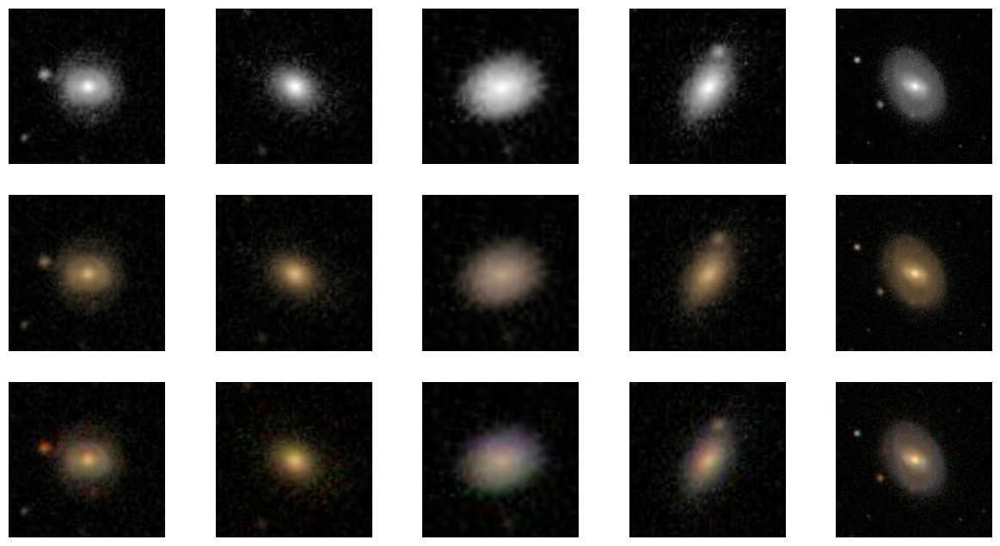

Checkpoint saved: /kaggle/working/Generator Checkpoints/generator_epoch_1.pth


Epoch 2/20:   0%|          | 0/1125 [00:00<?, ?it/s]


Epoch 2/20 Losses:
loss_D_fake: 0.12824
loss_D_real: 0.14984
loss_D: 0.13904
loss_G_GAN: 4.58168
loss_G_L1: 1.60415
loss_G: 6.18583


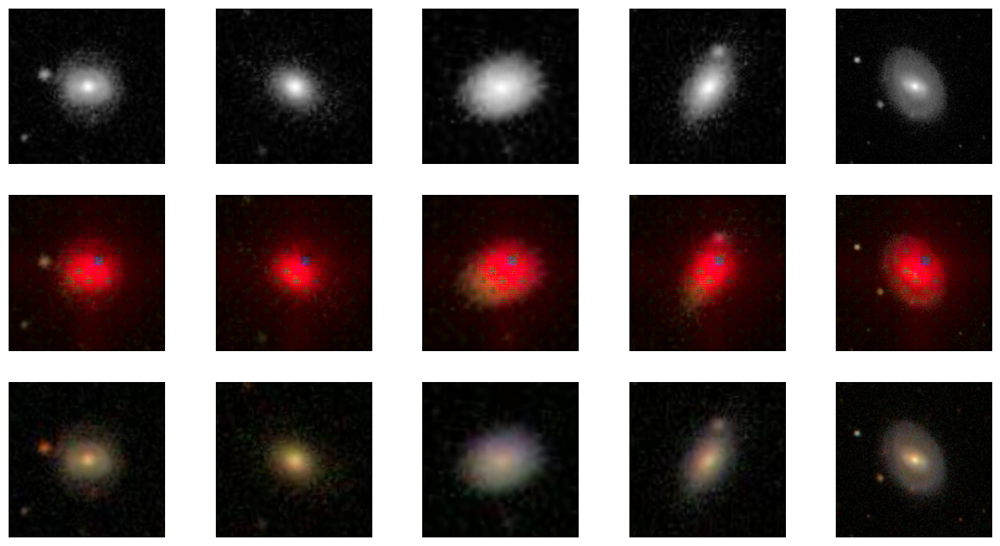

Checkpoint saved: /kaggle/working/Generator Checkpoints/generator_epoch_2.pth


Epoch 3/20:   0%|          | 0/1125 [00:00<?, ?it/s]


Epoch 3/20 Losses:
loss_D_fake: 0.20455
loss_D_real: 0.24190
loss_D: 0.22323
loss_G_GAN: 4.11665
loss_G_L1: 1.59043
loss_G: 5.70708


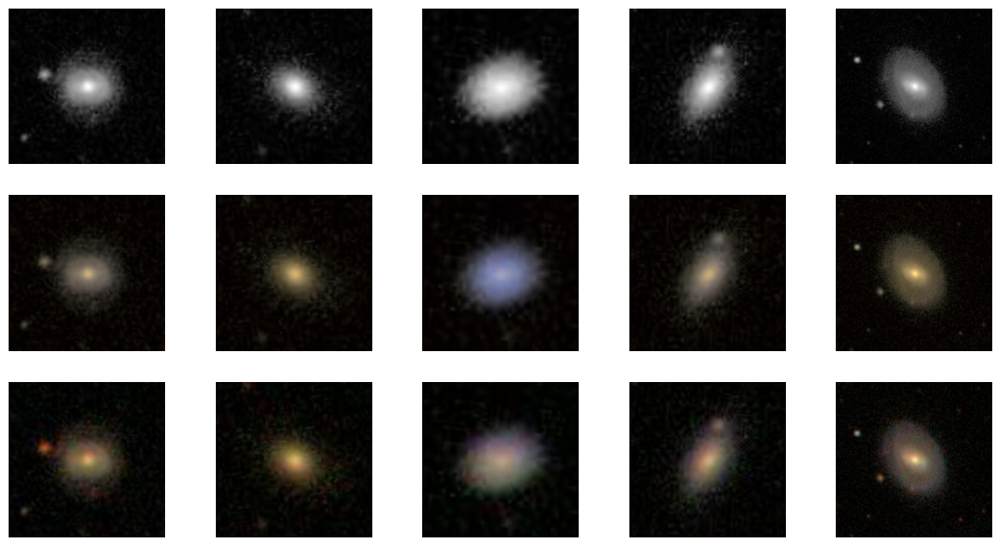

Checkpoint saved: /kaggle/working/Generator Checkpoints/generator_epoch_3.pth


Epoch 4/20:   0%|          | 0/1125 [00:00<?, ?it/s]


Epoch 4/20 Losses:
loss_D_fake: 0.58879
loss_D_real: 0.60185
loss_D: 0.59532
loss_G_GAN: 1.33765
loss_G_L1: 1.55352
loss_G: 2.89116


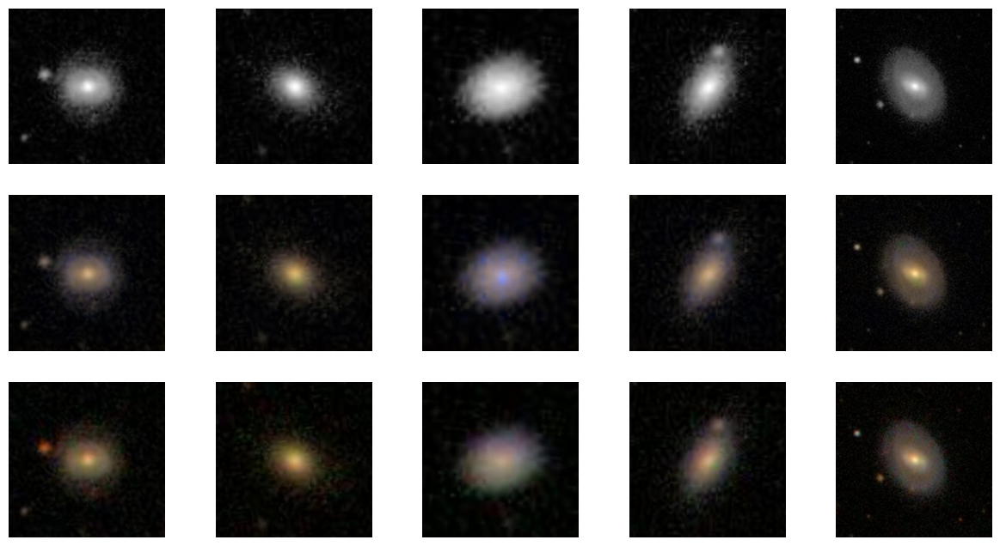

Checkpoint saved: /kaggle/working/Generator Checkpoints/generator_epoch_4.pth


Epoch 5/20:   0%|          | 0/1125 [00:00<?, ?it/s]


Epoch 5/20 Losses:
loss_D_fake: 0.51944
loss_D_real: 0.53768
loss_D: 0.52856
loss_G_GAN: 1.81997
loss_G_L1: 1.61104
loss_G: 3.43102


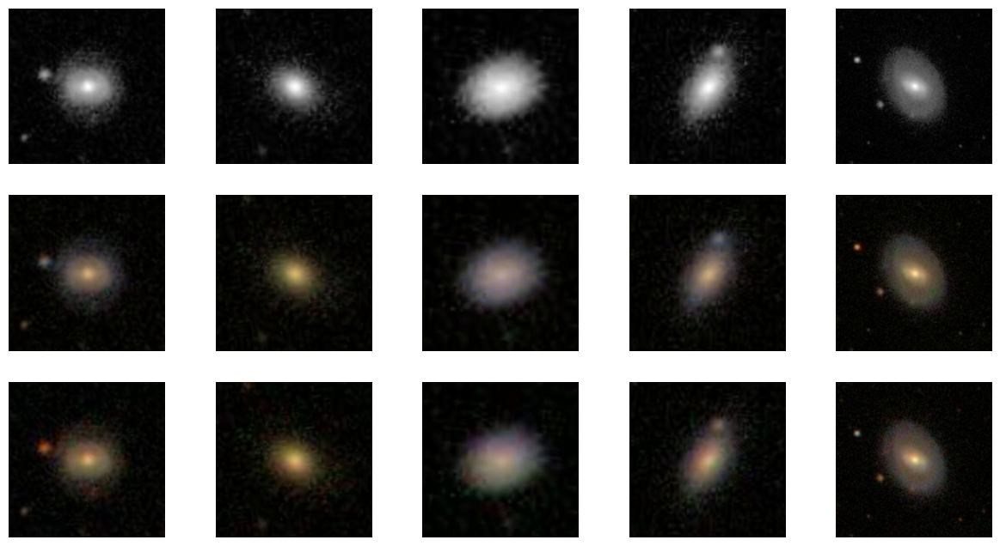

Checkpoint saved: /kaggle/working/Generator Checkpoints/generator_epoch_5.pth


Epoch 6/20:   0%|          | 0/1125 [00:00<?, ?it/s]


Epoch 6/20 Losses:
loss_D_fake: 0.47716
loss_D_real: 0.49308
loss_D: 0.48512
loss_G_GAN: 2.06755
loss_G_L1: 1.58631
loss_G: 3.65386


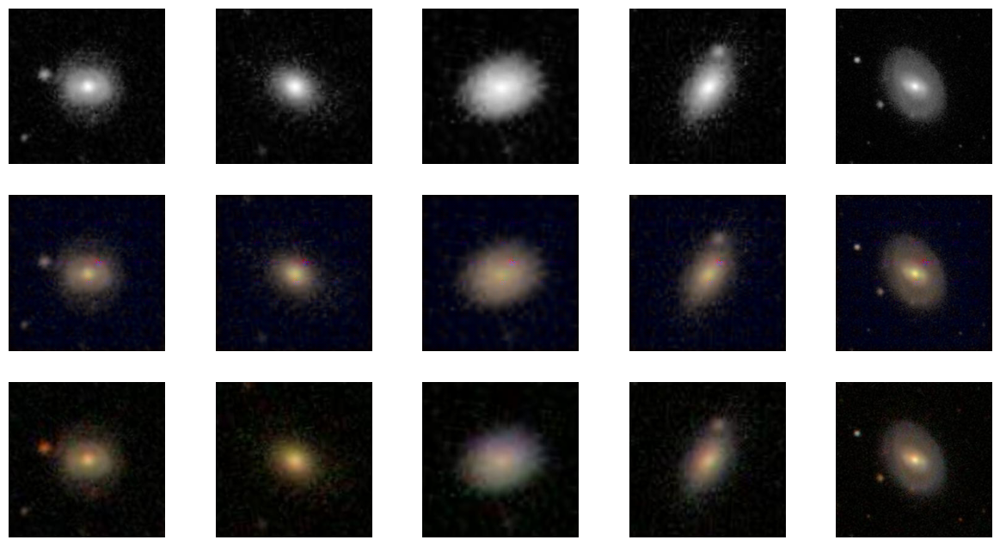

Checkpoint saved: /kaggle/working/Generator Checkpoints/generator_epoch_6.pth


Epoch 7/20:   0%|          | 0/1125 [00:00<?, ?it/s]


Epoch 7/20 Losses:
loss_D_fake: 0.53691
loss_D_real: 0.56326
loss_D: 0.55009
loss_G_GAN: 1.63222
loss_G_L1: 1.50400
loss_G: 3.13622


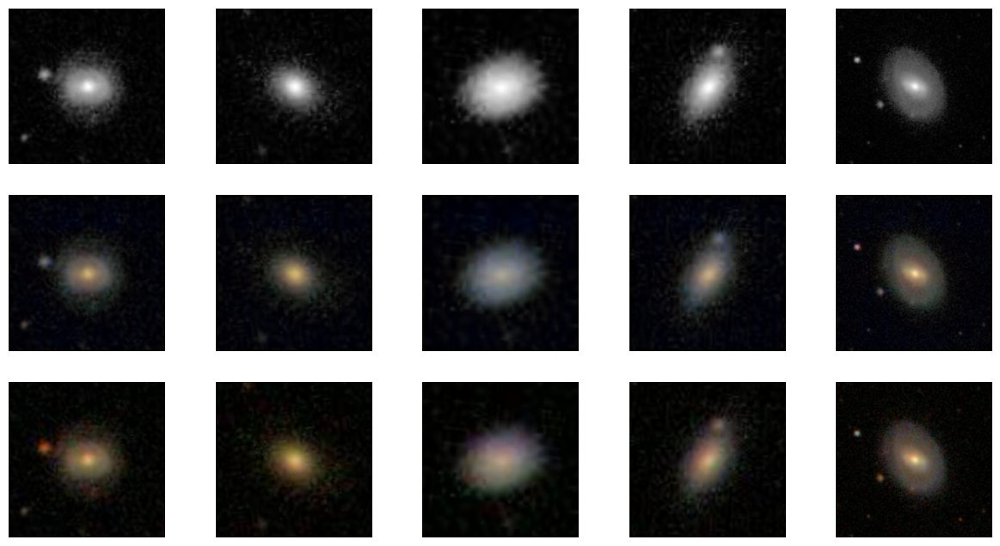

Checkpoint saved: /kaggle/working/Generator Checkpoints/generator_epoch_7.pth


Epoch 8/20:   0%|          | 0/1125 [00:00<?, ?it/s]


Epoch 8/20 Losses:
loss_D_fake: 0.59224
loss_D_real: 0.60343
loss_D: 0.59783
loss_G_GAN: 1.25683
loss_G_L1: 1.49442
loss_G: 2.75125


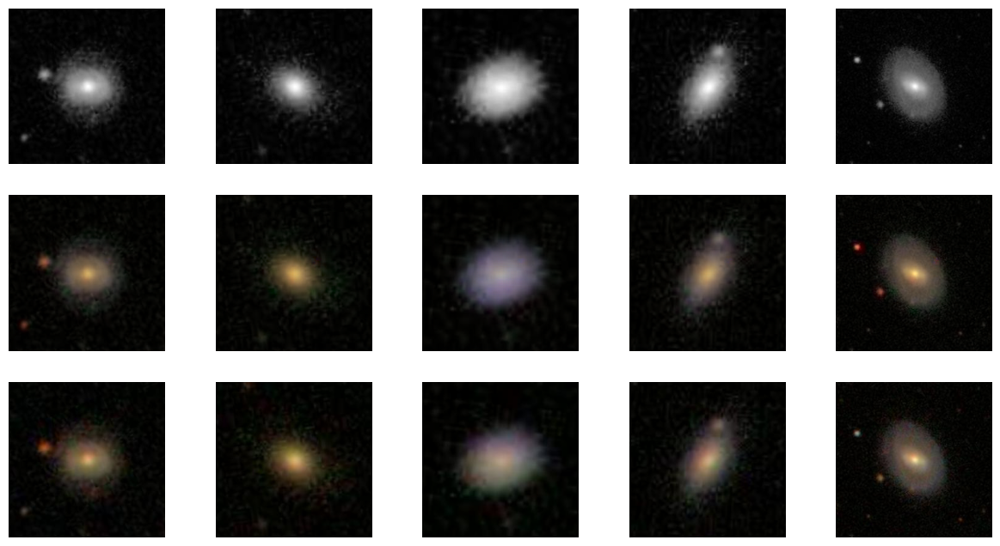

Checkpoint saved: /kaggle/working/Generator Checkpoints/generator_epoch_8.pth


Epoch 9/20:   0%|          | 0/1125 [00:00<?, ?it/s]


Epoch 9/20 Losses:
loss_D_fake: 0.68015
loss_D_real: 0.69148
loss_D: 0.68581
loss_G_GAN: 0.78915
loss_G_L1: 1.45659
loss_G: 2.24574


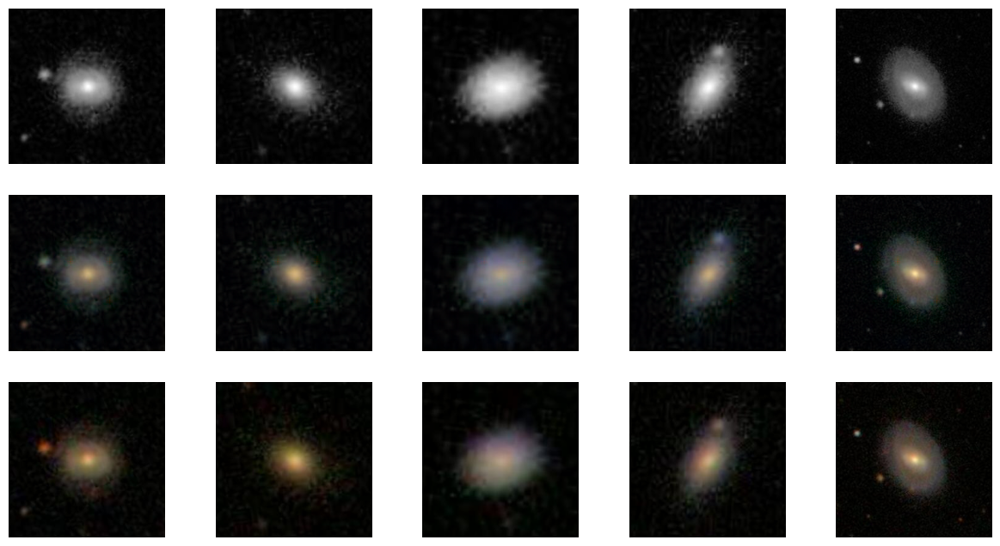

Checkpoint saved: /kaggle/working/Generator Checkpoints/generator_epoch_9.pth


Epoch 10/20:   0%|          | 0/1125 [00:00<?, ?it/s]


Epoch 10/20 Losses:
loss_D_fake: 0.68477
loss_D_real: 0.69247
loss_D: 0.68862
loss_G_GAN: 0.82406
loss_G_L1: 1.42015
loss_G: 2.24422


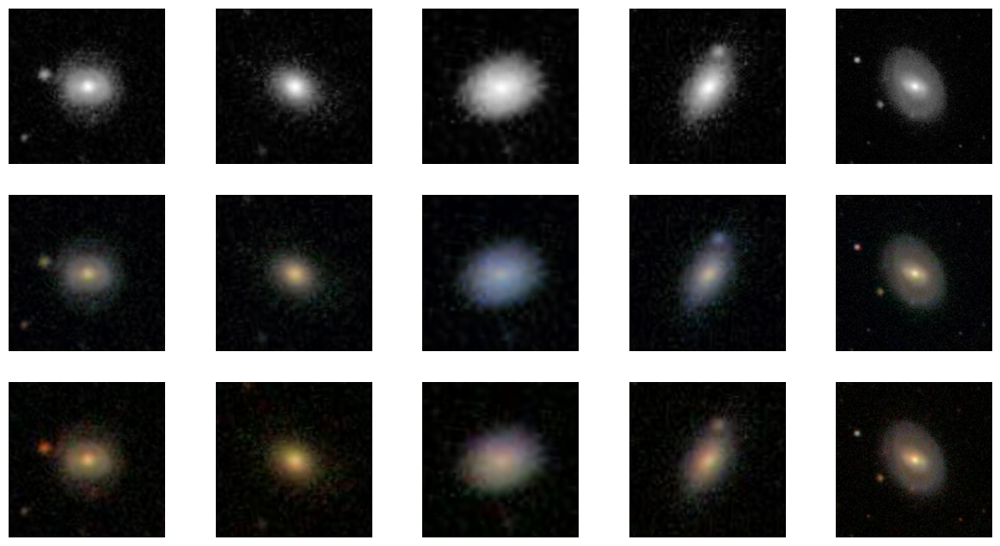

Checkpoint saved: /kaggle/working/Generator Checkpoints/generator_epoch_10.pth


Epoch 11/20:   0%|          | 0/1125 [00:00<?, ?it/s]


Epoch 11/20 Losses:
loss_D_fake: 0.67845
loss_D_real: 0.68935
loss_D: 0.68390
loss_G_GAN: 0.79228
loss_G_L1: 1.41637
loss_G: 2.20864


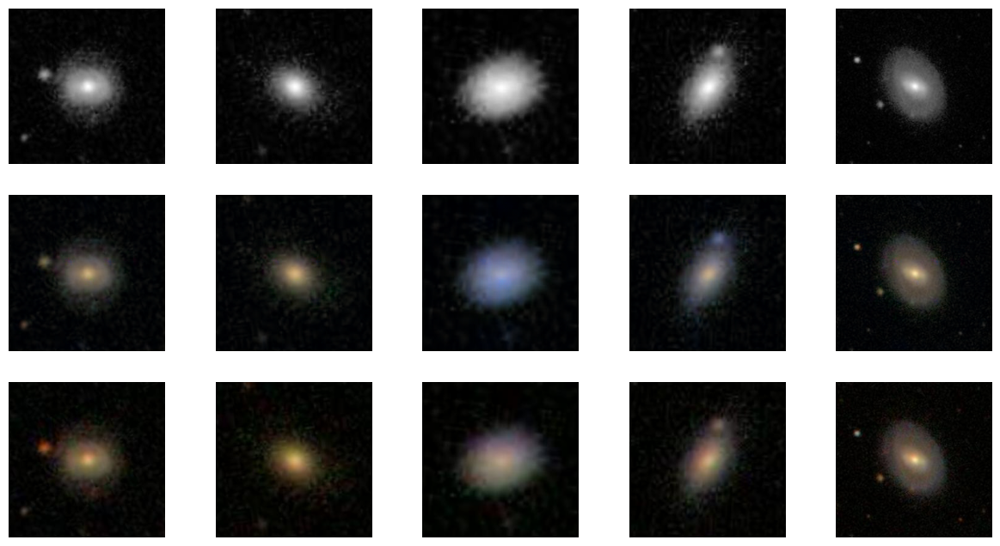

Checkpoint saved: /kaggle/working/Generator Checkpoints/generator_epoch_11.pth


Epoch 12/20:   0%|          | 0/1125 [00:00<?, ?it/s]


Epoch 12/20 Losses:
loss_D_fake: 0.67439
loss_D_real: 0.68406
loss_D: 0.67923
loss_G_GAN: 0.83991
loss_G_L1: 1.39683
loss_G: 2.23674


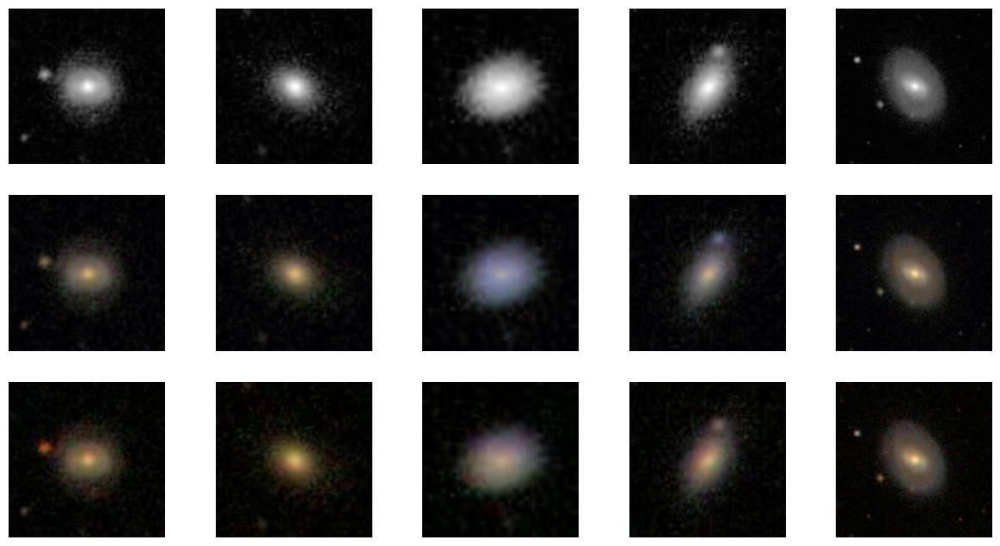

Checkpoint saved: /kaggle/working/Generator Checkpoints/generator_epoch_12.pth


Epoch 13/20:   0%|          | 0/1125 [00:00<?, ?it/s]


Epoch 13/20 Losses:
loss_D_fake: 0.67897
loss_D_real: 0.68630
loss_D: 0.68263
loss_G_GAN: 0.82154
loss_G_L1: 1.39458
loss_G: 2.21612


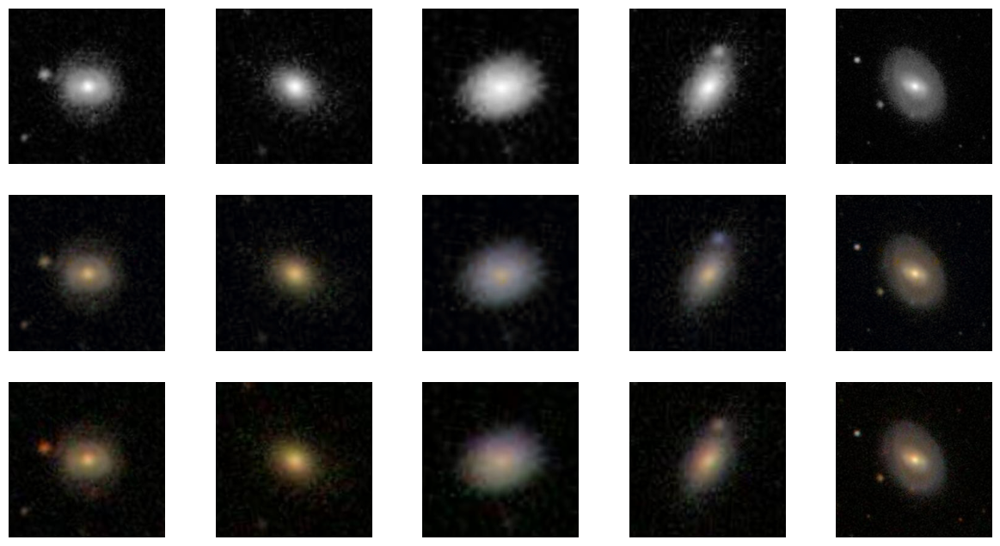

Checkpoint saved: /kaggle/working/Generator Checkpoints/generator_epoch_13.pth


Epoch 14/20:   0%|          | 0/1125 [00:00<?, ?it/s]


Epoch 14/20 Losses:
loss_D_fake: 0.67675
loss_D_real: 0.68258
loss_D: 0.67967
loss_G_GAN: 0.82398
loss_G_L1: 1.38538
loss_G: 2.20936


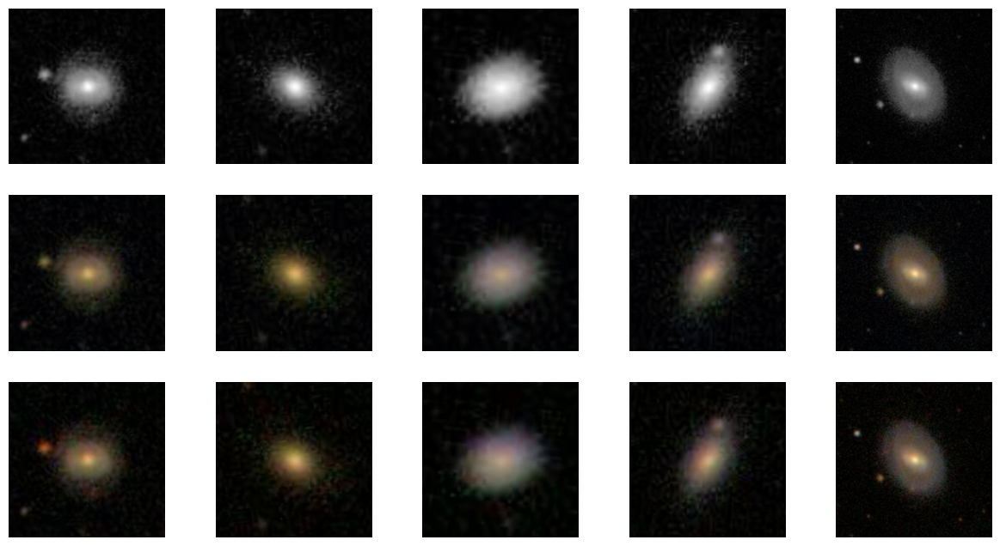

Checkpoint saved: /kaggle/working/Generator Checkpoints/generator_epoch_14.pth


Epoch 15/20:   0%|          | 0/1125 [00:00<?, ?it/s]


Epoch 15/20 Losses:
loss_D_fake: 0.67562
loss_D_real: 0.68153
loss_D: 0.67857
loss_G_GAN: 0.83942
loss_G_L1: 1.36851
loss_G: 2.20793


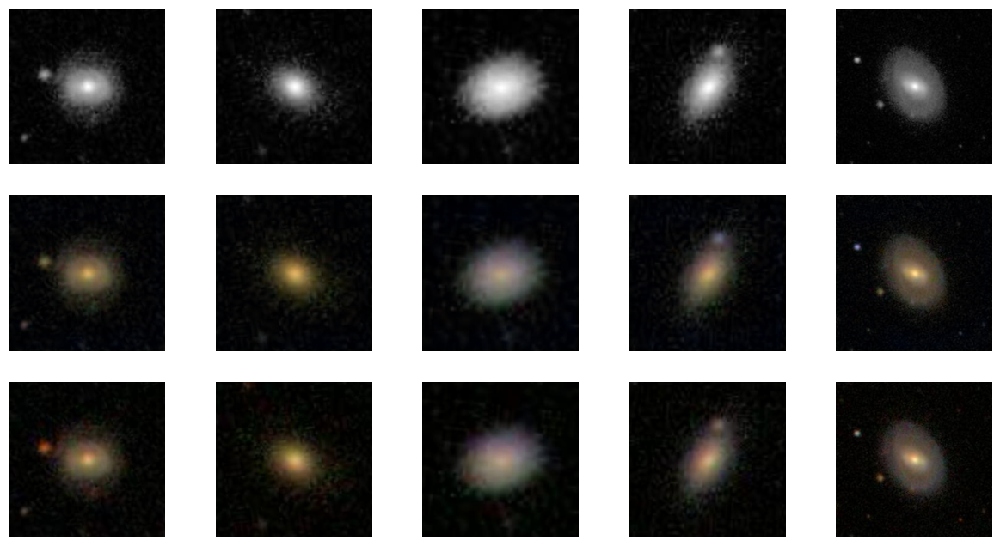

Checkpoint saved: /kaggle/working/Generator Checkpoints/generator_epoch_15.pth


Epoch 16/20:   0%|          | 0/1125 [00:00<?, ?it/s]


Epoch 16/20 Losses:
loss_D_fake: 0.62497
loss_D_real: 0.62718
loss_D: 0.62608
loss_G_GAN: 1.20029
loss_G_L1: 1.36629
loss_G: 2.56658


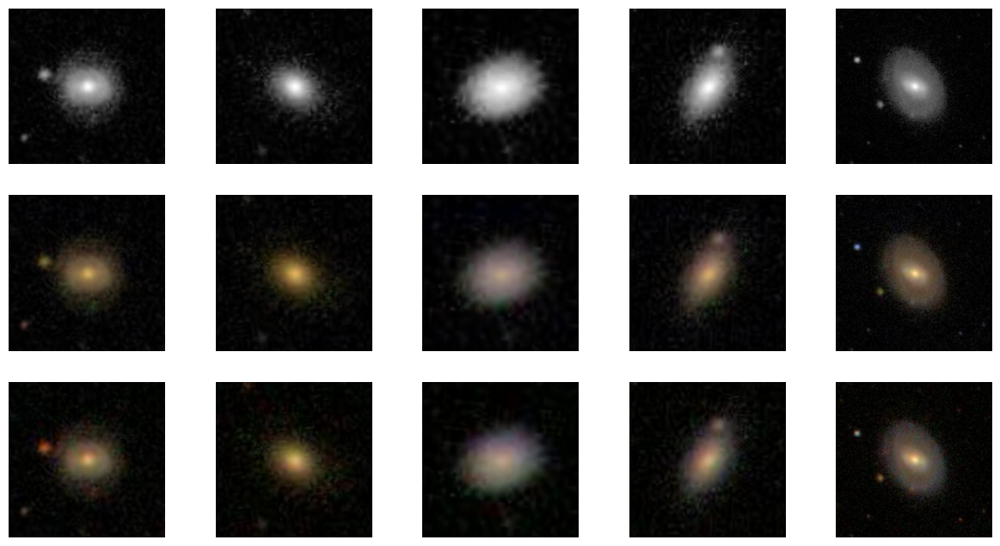

Checkpoint saved: /kaggle/working/Generator Checkpoints/generator_epoch_16.pth


Epoch 17/20:   0%|          | 0/1125 [00:00<?, ?it/s]


Epoch 17/20 Losses:
loss_D_fake: 0.67106
loss_D_real: 0.67937
loss_D: 0.67521
loss_G_GAN: 0.80527
loss_G_L1: 1.34319
loss_G: 2.14846


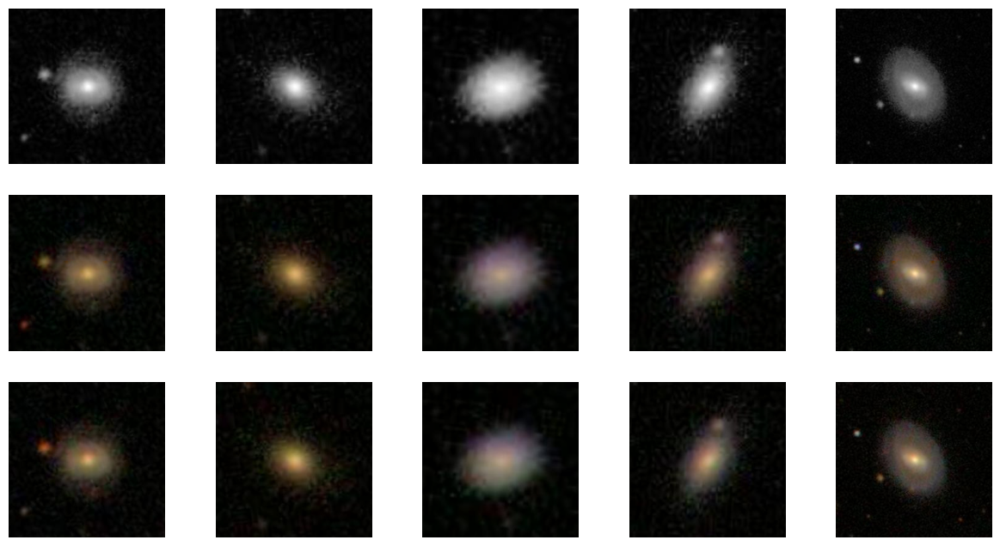

Checkpoint saved: /kaggle/working/Generator Checkpoints/generator_epoch_17.pth


Epoch 18/20:   0%|          | 0/1125 [00:00<?, ?it/s]


Epoch 18/20 Losses:
loss_D_fake: 0.65490
loss_D_real: 0.65895
loss_D: 0.65693
loss_G_GAN: 0.92238
loss_G_L1: 1.33039
loss_G: 2.25277


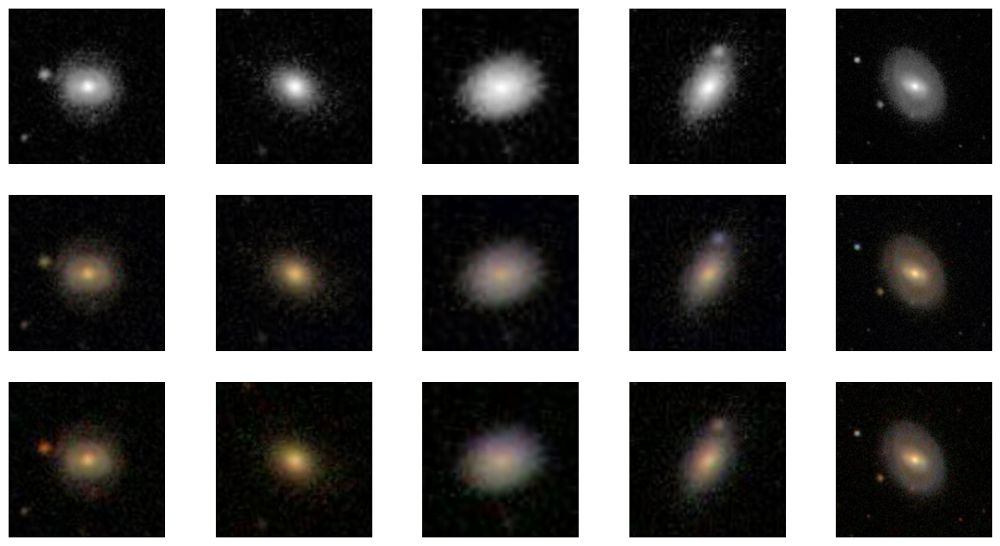

Checkpoint saved: /kaggle/working/Generator Checkpoints/generator_epoch_18.pth


Epoch 19/20:   0%|          | 0/1125 [00:00<?, ?it/s]


Epoch 19/20 Losses:
loss_D_fake: 0.62480
loss_D_real: 0.63000
loss_D: 0.62740
loss_G_GAN: 1.08931
loss_G_L1: 1.33757
loss_G: 2.42689


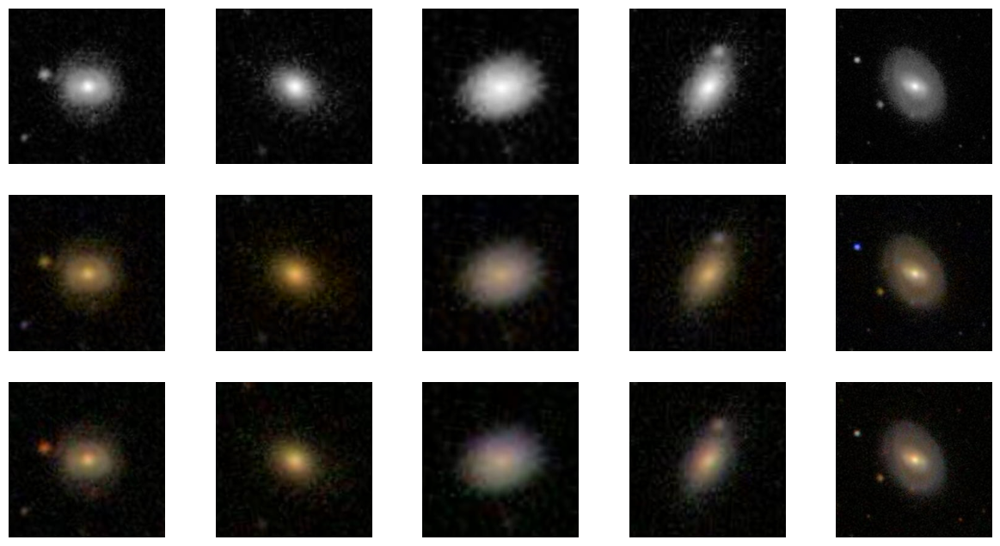

Checkpoint saved: /kaggle/working/Generator Checkpoints/generator_epoch_19.pth


Epoch 20/20:   0%|          | 0/1125 [00:00<?, ?it/s]


Epoch 20/20 Losses:
loss_D_fake: 0.60892
loss_D_real: 0.61499
loss_D: 0.61196
loss_G_GAN: 1.10314
loss_G_L1: 1.33931
loss_G: 2.44245


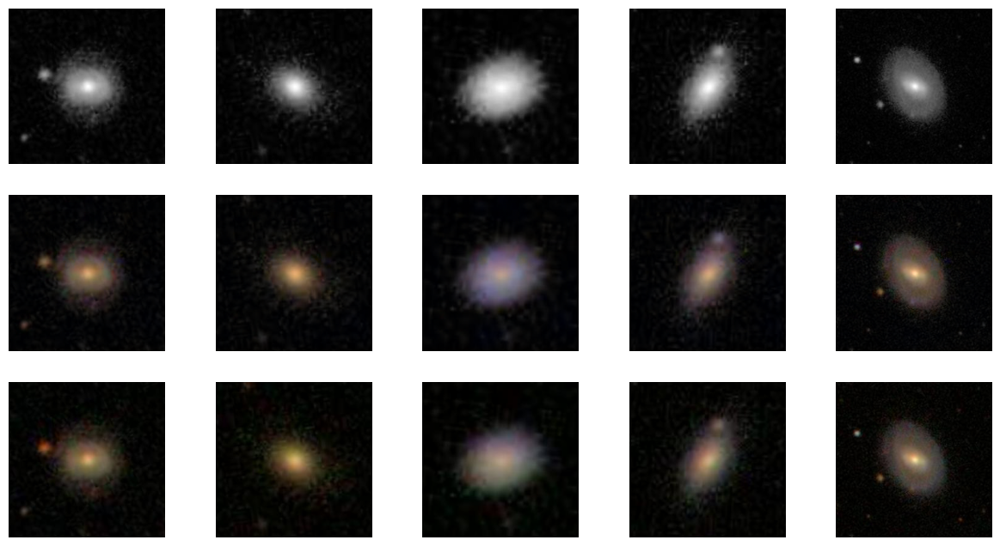

Checkpoint saved: /kaggle/working/Generator Checkpoints/generator_epoch_20.pth


In [32]:
# Initialize model and start training
model = MainModel()
loss_meter_dict_output = train_model(model, train_dl, epochs=20, save_every=1)

## 13. Human-Based Analysis of Generator Model Performance

In [85]:
# Create an instance of the Unet class with specified parameters
generator = Unet(input_c=1, output_c=2, n_down=8, num_filters=64)

# Load the model's state dictionary (weights and biases) from a file
# The file path is provided by the user via standard input
generator.load_state_dict(torch.load(input('Enter the model path:- ')))

# Determine if a CUDA-enabled GPU is available; if not, use the CPU
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Move the generator model to the appropriate device (GPU or CPU)
generator.to(device)

# Set the model to evaluation mode
# This disables certain features like dropout and batch normalization that are only used during training
generator.eval()

Enter the model path:-  /kaggle/working/Generator Checkpoints/generator_epoch_17.pth


Unet(
  (model): UnetBlock(
    (model): Sequential(
      (0): Conv2d(1, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): UnetBlock(
        (model): Sequential(
          (0): LeakyReLU(negative_slope=0.2, inplace=True)
          (1): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
          (2): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (3): UnetBlock(
            (model): Sequential(
              (0): LeakyReLU(negative_slope=0.2, inplace=True)
              (1): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
              (2): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
              (3): UnetBlock(
                (model): Sequential(
                  (0): LeakyReLU(negative_slope=0.2, inplace=True)
                  (1): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
 

In [ ]:
def visualize_single_image(L, fake_color, real_color):
    """
    Visualize grayscale, generated RGB, and real RGB images for a single image.
    
    Parameters
    ----------
    L : tensor
        Grayscale image tensor.
    fake_color : tensor
        Generated RGB image tensor.
    real_color : tensor
        Real RGB image tensor.
    """
    # Convert tensors to RGB images using custom lab_to_rgb
    fake_img = lab_to_rgb(L, fake_color).squeeze(0)
    real_img = lab_to_rgb(L, real_color).squeeze(0)
    
    # Visualization for the single image
    fig, ax = plt.subplots(1, 3, figsize=(15, 5))  # 1 row, 3 columns
    
    # Grayscale input
    ax[0].imshow(L[0][0].cpu(), cmap='gray')
    ax[0].axis('off')
    ax[0].set_title('Grayscale Input')
    
    # Fake color image
    ax[1].imshow(fake_img)
    ax[1].axis('off')
    ax[1].set_title('Generated RGB Image')
    
    # Real color image
    ax[2].imshow(real_img)
    ax[2].axis('off')
    ax[2].set_title('Real RGB Image')
    
    plt.show()

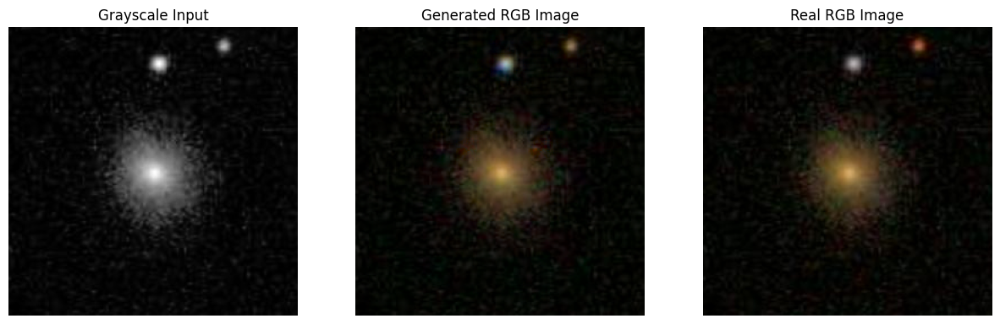

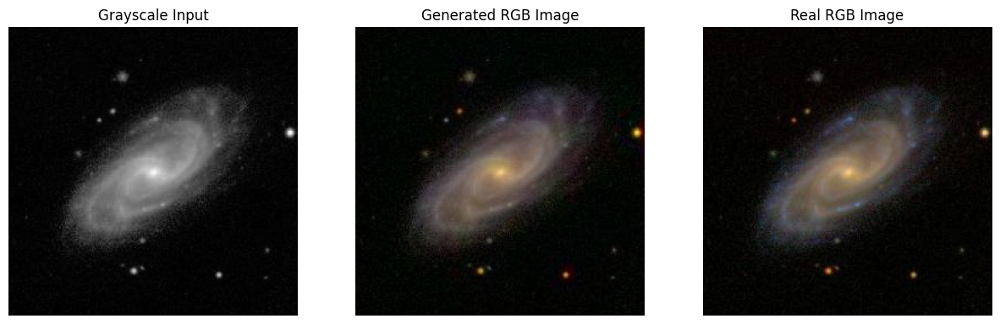

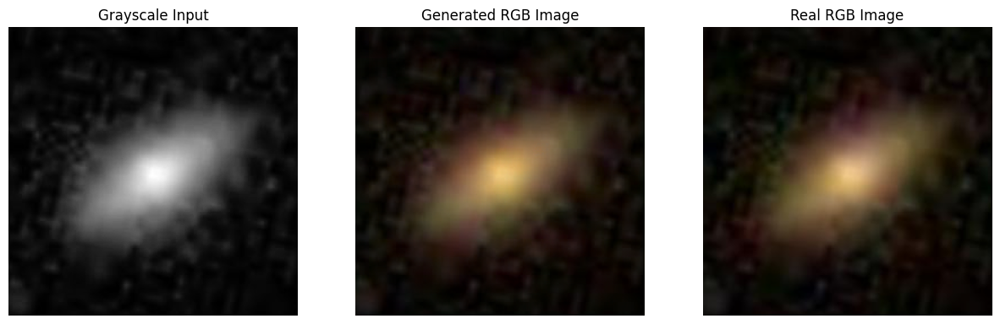

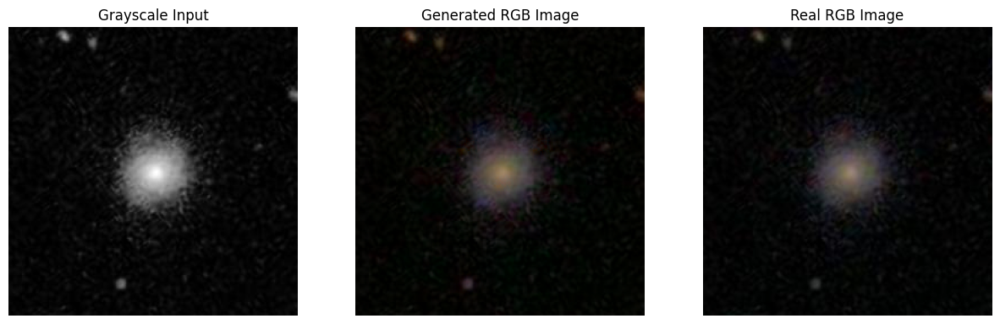

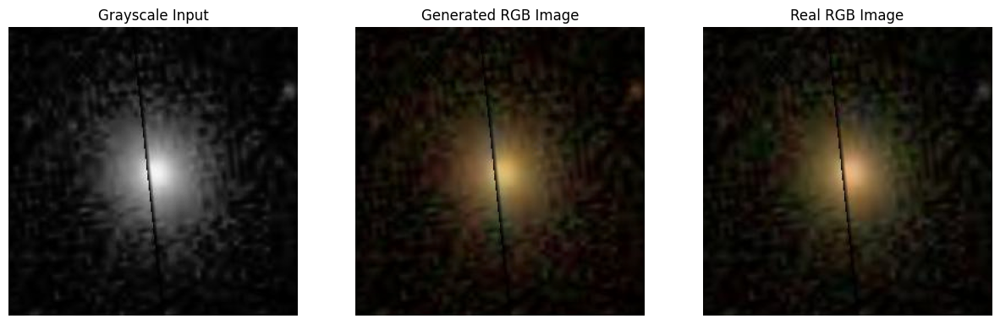

...

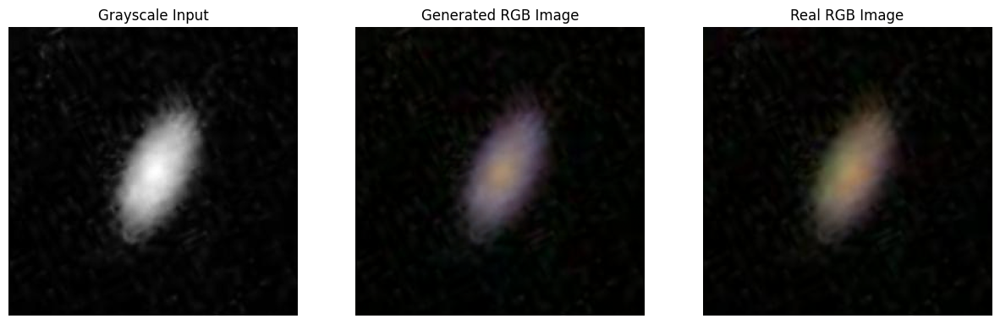

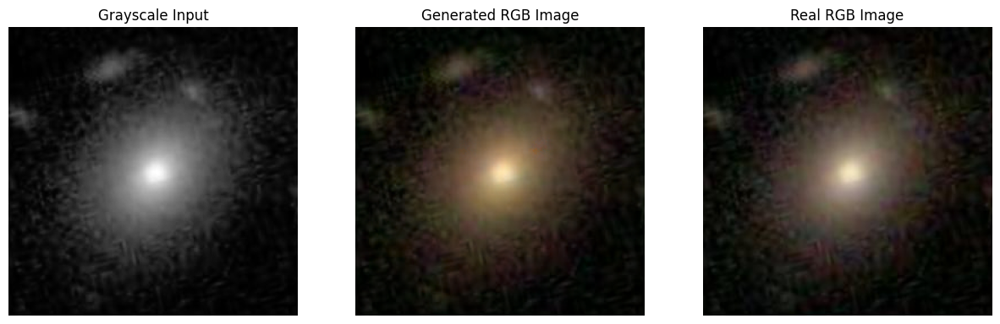

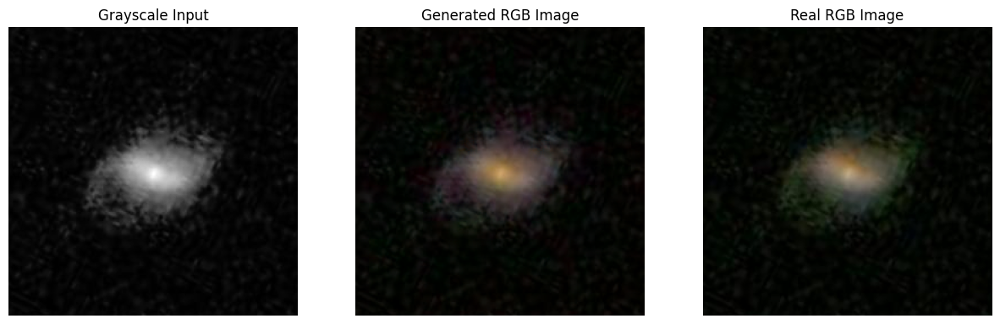

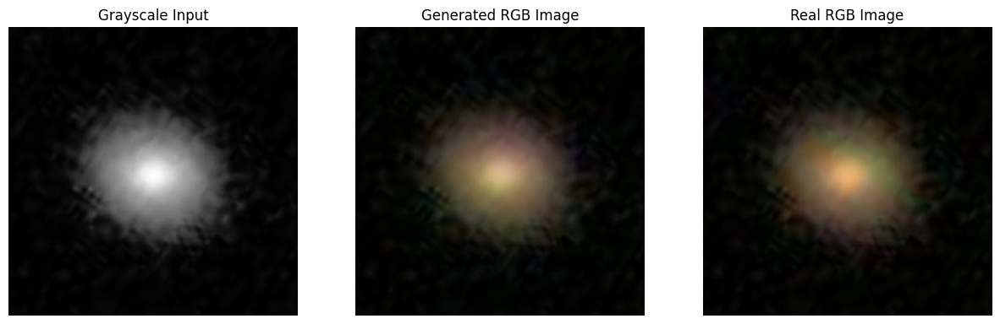

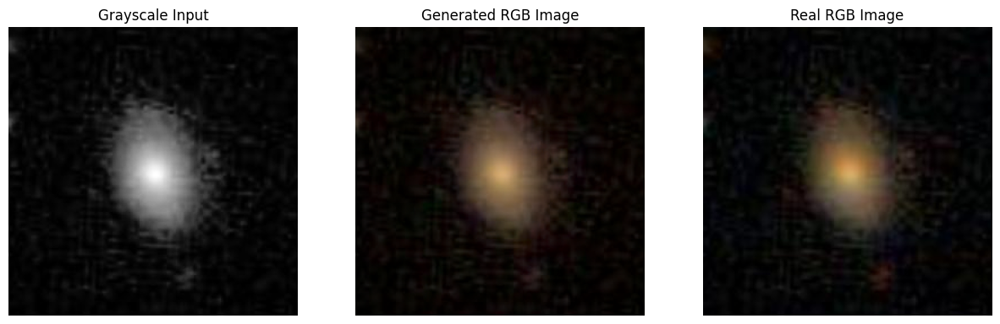

In [113]:
# Run inference on the validation set
with torch.no_grad():
    for data in val_dl:
        inputs = data['L'].to(device)
        targets = data['ab'].to(device)
        
        # Pass the entire batch through the generator
        outputs = generator(inputs)

        # Process the outputs
        fake_color_batch = outputs.detach()
        
        # Visualize each image in the batch
        for i in range(inputs.size(0)):  # Loop through each image in the batch
            L = inputs[i:i+1]
            fake_color = fake_color_batch[i:i+1]
            real_color = targets[i:i+1]

            visualize_single_image(L, fake_color, real_color)

        break  # Stop after the first batch (for demonstration)


## 14. Generator Model Inferences Based on PSNR and SSIM Values on Validation and Test Dataset

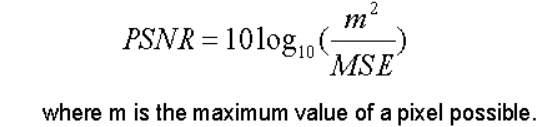

* PSNR measures the quality of reconstructed images by comparing the peak signal power to the noise power. 
* It's calculated as the ratio between the maximum possible pixel value of the image and the MSE between the original and the generated images. 
* Higher PSNR values generally indicate better quality.
* Higher values (e.g., 30 dB and above) typically indicate better quality and closer resemblance to the original image.
* While PSNR is useful for assessing overall quality, it may not fully capture perceptual quality or structural fidelity. 
* For color images, especially those with subtle color details, PSNR may not always align with human perception. 
* Thus, combining PSNR with other metrics like Structural Similarity Index (SSIM) can provide a more comprehensive evaluation.

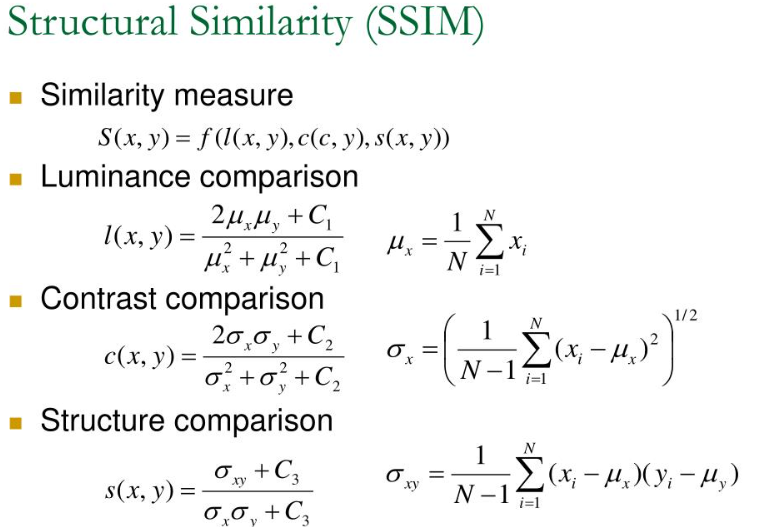

*  SSIM measures the similarity between two images by considering changes in structural information, luminance, and contrast. 
* It is designed to assess perceptual quality by comparing the structural aspects of the images, which are more aligned with human visual perception.
* **Structure:** Evaluates the similarity in structural patterns between the images. It is based on the correlation between pixel values in local regions.
* **Luminance:** Measures the similarity in brightness between the images. It is calculated based on the mean of the pixel values.
* **Contrast:** Assesses the similarity in contrast between the images. This is determined by the standard deviation of the pixel values.
* SSIM values range from -1 to 1, where 1 indicates perfect similarity between the two images, 0 indicates no similarity.
* Negative values of SSIM are not typically encountered in practical scenarios.
* Hence, using both PSNR and SSIM together provides a more comprehensive assessment of the quality of generated colorful images. 


In [ ]:
from skimage.metrics import peak_signal_noise_ratio as psnr

def calculate_psnr(real_img, fake_img):
    """
    Calculate PSNR between the real and fake images.
    
    Parameters
    ----------
    real_img : numpy array
        Real RGB image.
    fake_img : numpy array
        Generated RGB image.
        
    Returns
    -------
    float
        PSNR value.
    """
    return psnr(real_img, fake_img, data_range=fake_img.max() - fake_img.min())

In [119]:
from skimage.metrics import structural_similarity as ssim

def calculate_ssim(real_img, fake_img):
    """
    Calculate SSIM between the real and fake images.
    
    Parameters
    ----------
    real_img : numpy array
        Real RGB image.
    fake_img : numpy array
        Generated RGB image.
        
    Returns
    -------
    float
        SSIM value.
    """
    # Convert images to grayscale for SSIM calculation
    # SSIM is usually calculated on grayscale images, so convert RGB to grayscale
    real_img_gray = np.dot(real_img[...,:3], [0.2989, 0.5870, 0.1140])
    fake_img_gray = np.dot(fake_img[...,:3], [0.2989, 0.5870, 0.1140])
    return ssim(real_img_gray, fake_img_gray, data_range=fake_img_gray.max() - fake_img_gray.min())


In [120]:
def visualize_single_image(L, fake_color, real_color):
    """
    Visualize grayscale, generated RGB, and real RGB images with PSNR and SSIM.

    Parameters
    ----------
    L : tensor
        Grayscale image tensor.
    fake_color : tensor
        Generated RGB image tensor.
    real_color : tensor
        Real RGB image tensor.
    """
    # Convert tensors to RGB images using custom lab_to_rgb
    fake_img = lab_to_rgb(L, fake_color).squeeze(0)
    real_img = lab_to_rgb(L, real_color).squeeze(0)
    
    # Calculate PSNR and SSIM
    psnr_value = calculate_psnr(real_img, fake_img)
    ssim_value = calculate_ssim(real_img, fake_img)

    # Visualization for the single image
    fig, ax = plt.subplots(1, 3, figsize=(15, 5))  # 1 row, 3 columns
    
    # Grayscale input
    ax[0].imshow(L[0][0].cpu(), cmap='gray')
    ax[0].axis('off')
    ax[0].set_title('Grayscale Input')
    
    # Fake color image
    ax[1].imshow(fake_img)
    ax[1].axis('off')
    ax[1].set_title('Generated RGB Image')
    
    # Real color image
    ax[2].imshow(real_img)
    ax[2].axis('off')
    ax[2].set_title('Real RGB Image')
    
    plt.suptitle(f'PSNR: {psnr_value:.2f} dB | SSIM: {ssim_value:.4f}', fontsize=16)
    plt.show()
    
    return psnr_value, ssim_value

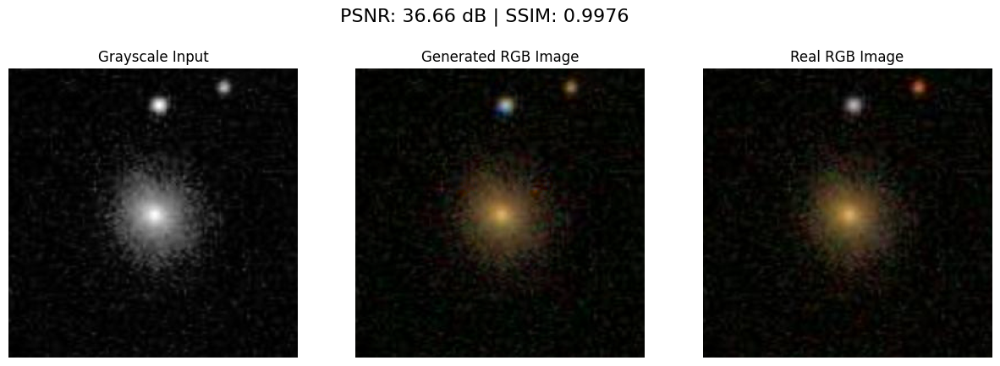

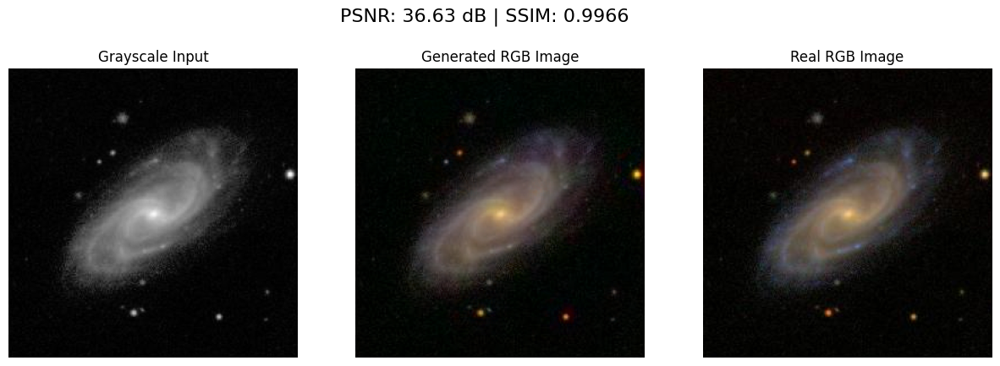

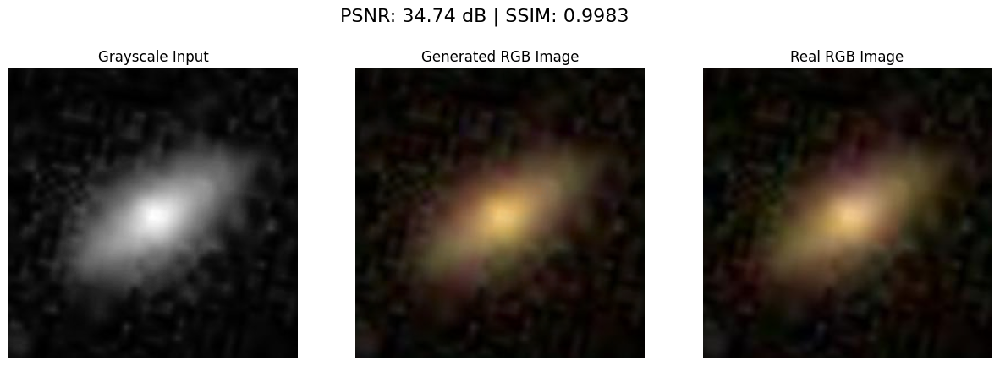

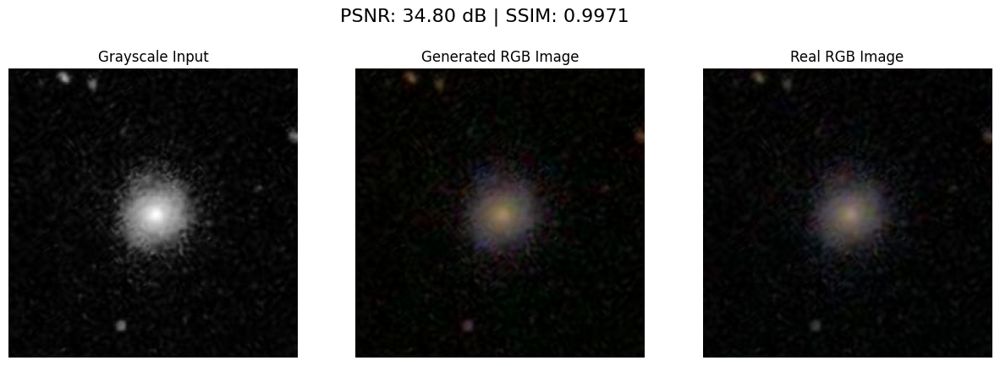

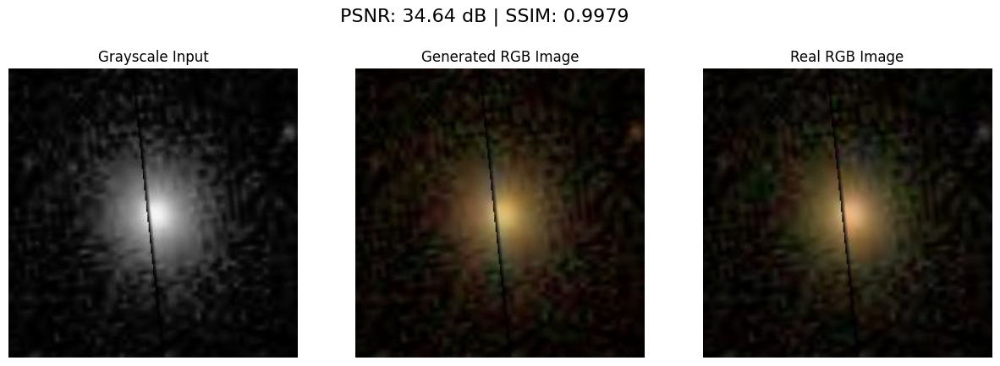

...

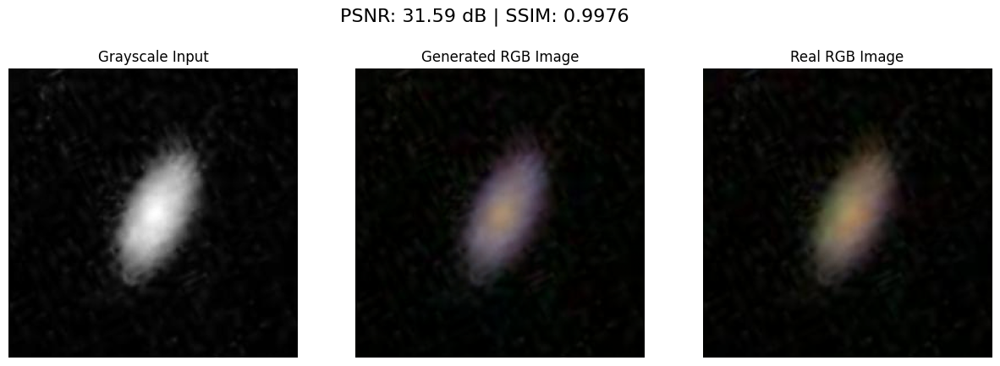

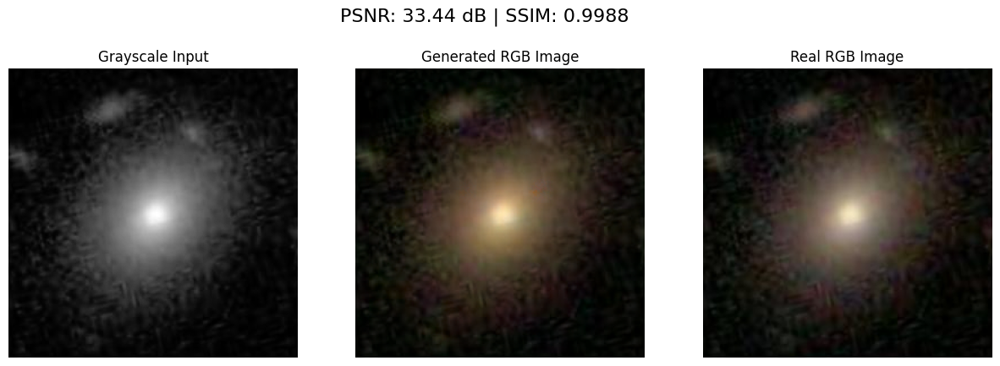

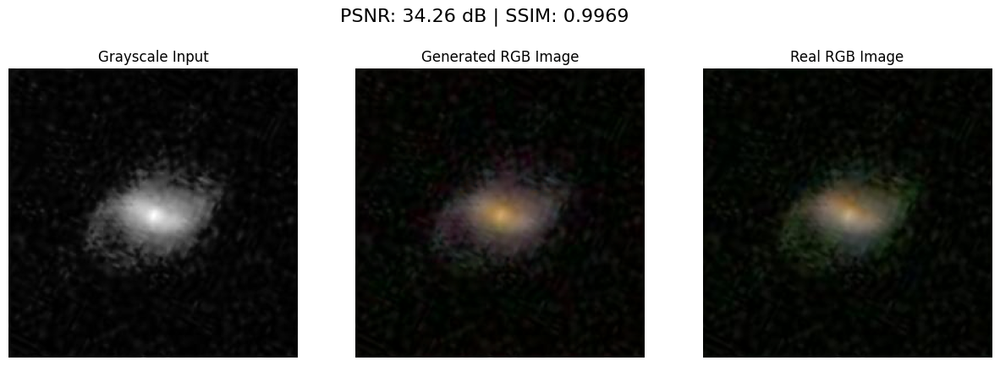

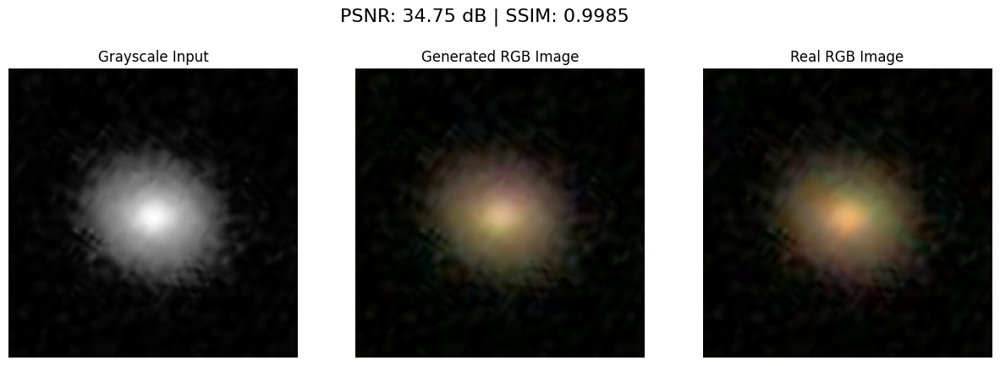

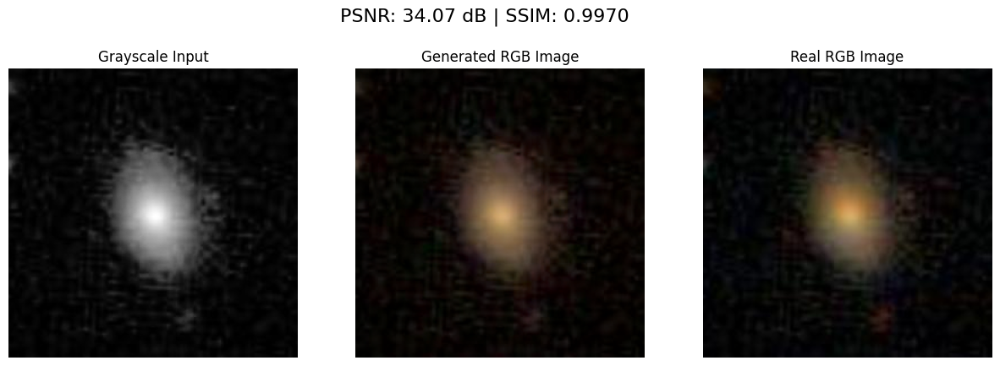

Average PSNR for Validation Data (Batch 1): 34.66 dB
Average SSIM for Validation Data (Batch 1): 0.9977


In [121]:
# Assuming you have a device setup and `generator` defined
psnr_values = []
ssim_values = []

# Run inference on the validation set
with torch.no_grad():
    for data in val_dl:
        inputs = data['L'].to(device)
        targets = data['ab'].to(device)
        
        # Pass the entire batch through the generator
        outputs = generator(inputs)

        # Process the outputs
        fake_color_batch = outputs.detach()
        
        # Visualize each image in the batch and calculate PSNR and SSIM
        for i in range(inputs.size(0)):  # Loop through each image in the batch
            L = inputs[i:i+1]
            fake_color = fake_color_batch[i:i+1]
            real_color = targets[i:i+1]
            
            # Visualize the current image and calculate PSNR and SSIM
            psnr_value, ssim_value = visualize_single_image(L, fake_color, real_color)
            psnr_values.append(psnr_value)
            ssim_values.append(ssim_value)
        
        break  # Stop after processing the first batch (for demonstration)
            
# Calculate and print the average PSNR and SSIM
if psnr_values:
    avg_psnr = np.mean(np.array(psnr_values))
    avg_ssim = np.mean(np.array(ssim_values))
    print(f'Average PSNR for Validation Data (Batch 1): {avg_psnr:.2f} dB')
    print(f'Average SSIM for Validation Data (Batch 1): {avg_ssim:.4f}')
else:
    print('No PSNR or SSIM values recorded.')

In [90]:
import zipfile

def unzip_limited_files(zip_path, extract_path, num_files=100):
    """
    Unzip a specified number of files from a ZIP archive.

    Parameters
    ----------
    zip_path : str
        Path to the ZIP file.
    extract_path : str
        Directory where files should be extracted.
    num_files : int
        Number of files to extract.
    """
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        # Get a list of all the files in the zip
        all_files = zip_ref.namelist()
        
        # Limit the number of files to extract
        files_to_extract = all_files[:num_files]
        
        # Extract only the specified files
        for file_name in files_to_extract:
            zip_ref.extract(file_name, extract_path)
            print(f"Extracted {file_name}")

zip_file_path = '/kaggle/input/galaxy-zoo-the-galaxy-challenge/images_test_rev1.zip'
extraction_folder = '/kaggle/working/Test Images'

# Create extraction folder if it doesn't exist
os.makedirs(extraction_folder, exist_ok=True)

# Extract the first 5 images
unzip_limited_files(zip_file_path, extraction_folder, num_files=100)


Extracted images_test_rev1/
Extracted images_test_rev1/100018.jpg
Extracted images_test_rev1/100037.jpg
Extracted images_test_rev1/100042.jpg
Extracted images_test_rev1/100052.jpg
Extracted images_test_rev1/100056.jpg
Extracted images_test_rev1/100058.jpg
Extracted images_test_rev1/100062.jpg
Extracted images_test_rev1/100065.jpg
Extracted images_test_rev1/100071.jpg
Extracted images_test_rev1/100076.jpg
Extracted images_test_rev1/100084.jpg
Extracted images_test_rev1/100085.jpg
Extracted images_test_rev1/100094.jpg
Extracted images_test_rev1/100104.jpg
Extracted images_test_rev1/100171.jpg
Extracted images_test_rev1/100183.jpg
Extracted images_test_rev1/100186.jpg
Extracted images_test_rev1/100190.jpg
Extracted images_test_rev1/100208.jpg
Extracted images_test_rev1/100222.jpg
Extracted images_test_rev1/100229.jpg
Extracted images_test_rev1/100232.jpg
Extracted images_test_rev1/100236.jpg
Extracted images_test_rev1/100256.jpg
Extracted images_test_rev1/100265.jpg
Extracted images_test_

In [91]:
testing_paths = '/kaggle/working/Test Images/images_test_rev1/*.jpg'

In [92]:
testing_paths = glob.glob(testing_paths)
testing_dl = make_dataloaders(paths=testing_paths, crop_size=SIZE)

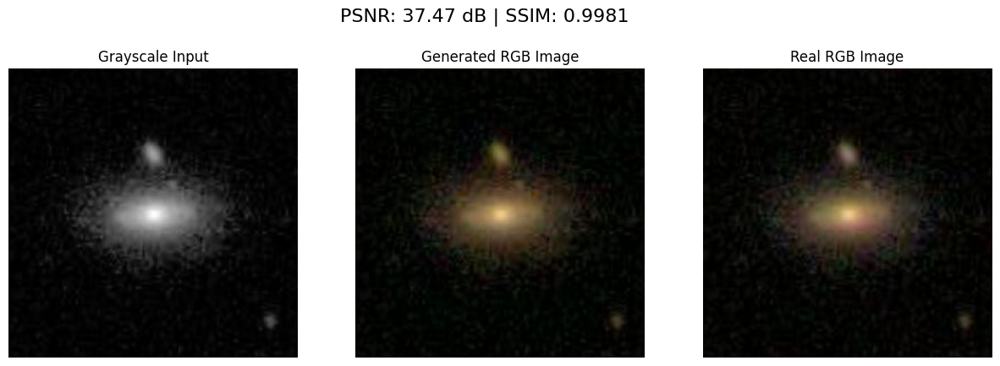

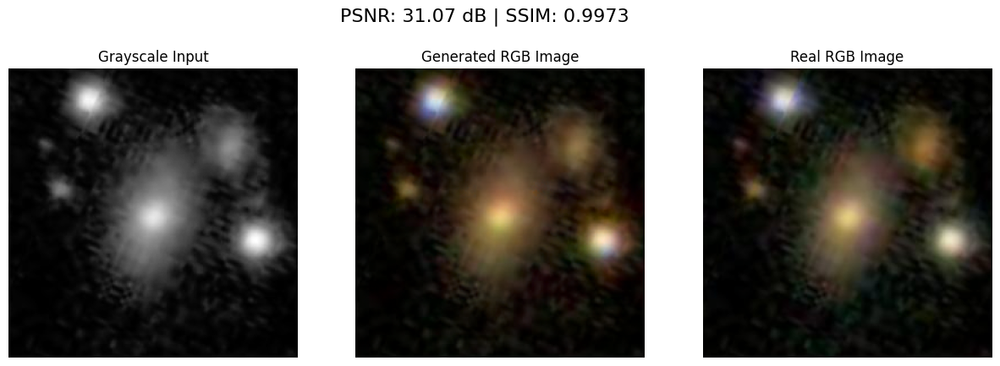

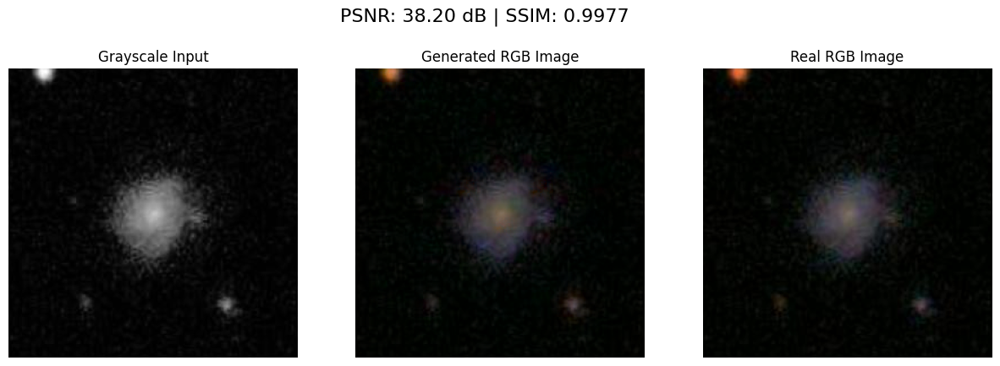

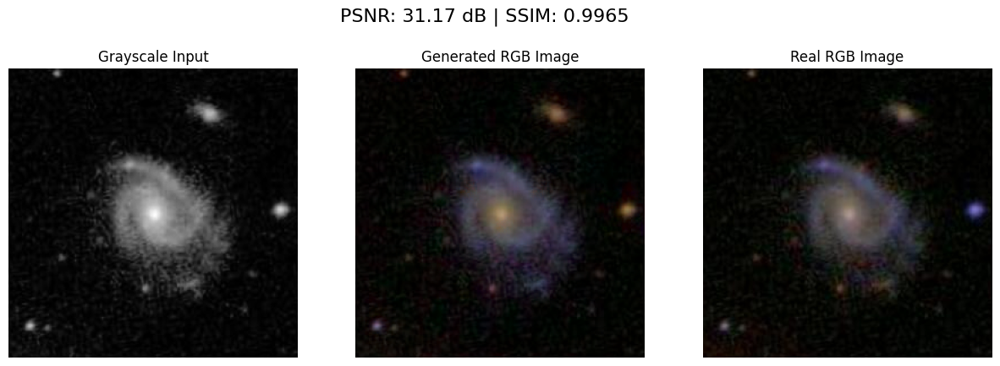

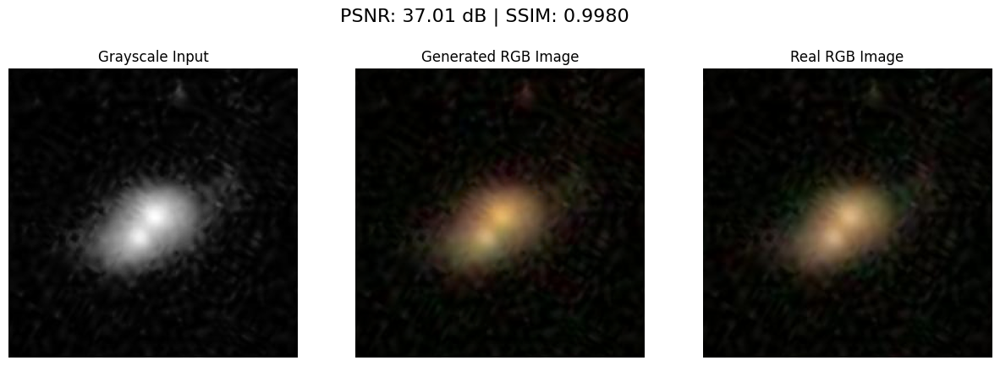

...

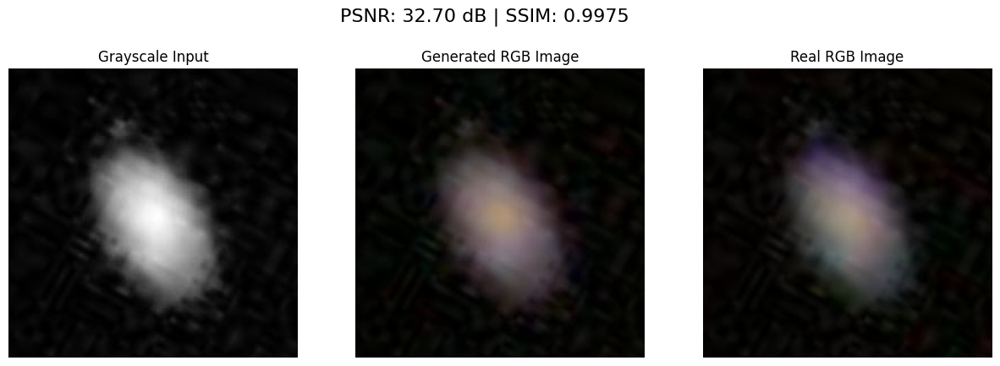

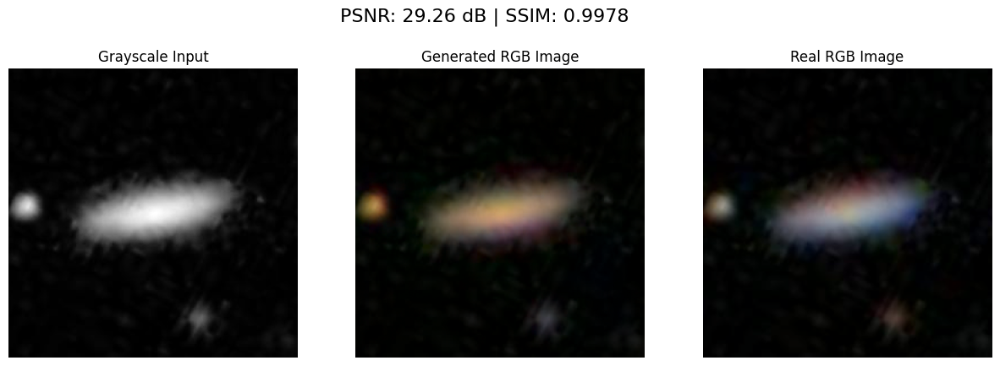

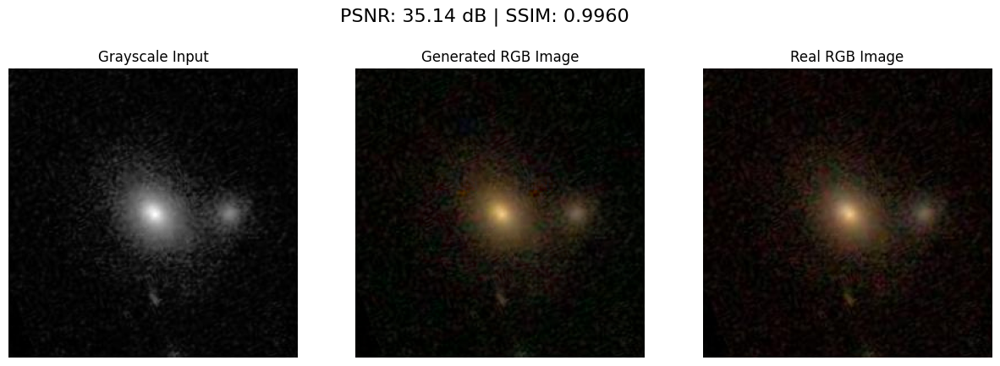

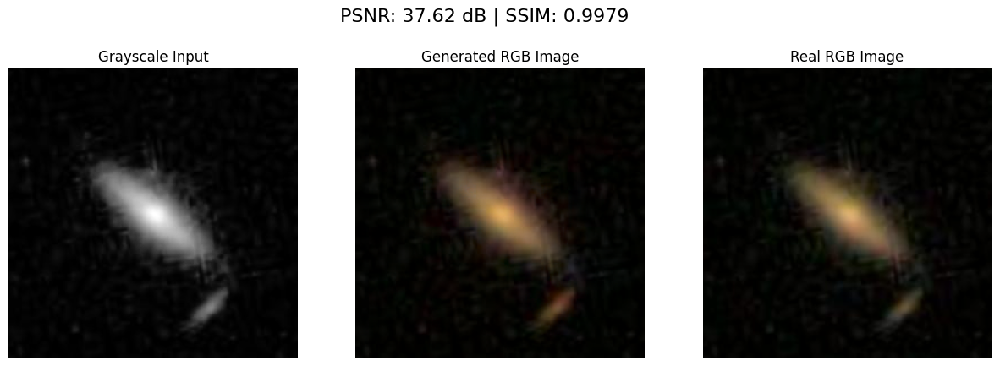

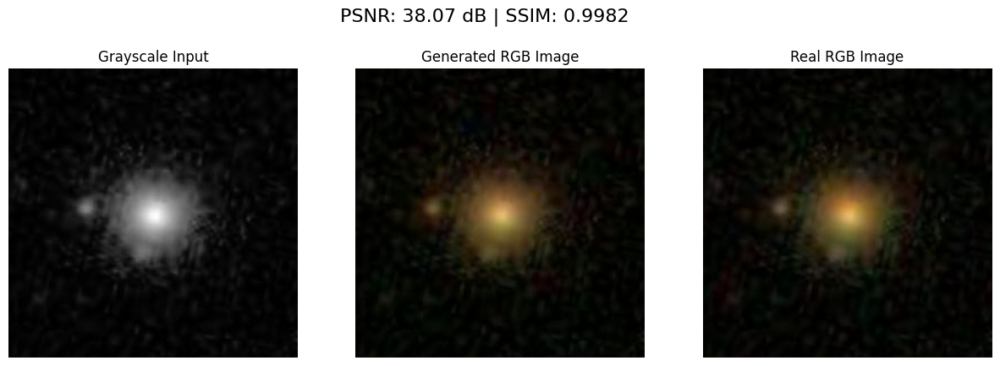

Average PSNR for Validation Data (Batch 1): 34.48 dB
Average SSIM for Validation Data (Batch 1): 0.9973


In [124]:
# Assuming you have a device setup and `generator` defined
psnr_values = []
ssim_values = []

# Run inference on the validation set
with torch.no_grad():
    # Iterate over the batches in the dataset
    for i, data in enumerate(testing_dl):
        if i == selected_batch_index:

            inputs = data['L'].to(device)
            targets = data['ab'].to(device)
            
            # Iterate over each image in the selected batch
            for img_idx in range(inputs.size(0)):
                L = inputs[img_idx:img_idx + 1]  # Get the current image
                real_color = targets[img_idx:img_idx + 1]  # Real color (ab channels) for the current image
                
                outputs = generator(L)

                # Process the outputs
                fake_color = outputs.detach()


                # Visualize the current image and calculate PSNR and SSIM
                psnr_value, ssim_value = visualize_single_image(L, fake_color, real_color)
                psnr_values.append(psnr_value)
                ssim_values.append(ssim_value)
        
            break  # Stop after processing the first batch (for demonstration)
            
# Calculate and print the average PSNR and SSIM
if psnr_values:
    avg_psnr = np.mean(np.array(psnr_values))
    avg_ssim = np.mean(np.array(ssim_values))
    print(f'Average PSNR for Validation Data (Batch 1): {avg_psnr:.2f} dB')
    print(f'Average SSIM for Validation Data (Batch 1): {avg_ssim:.4f}')
else:
    print('No PSNR or SSIM values recorded.')
        

## 15. Side by Side Visualization of BW Galaxy and Colorful Galaxy Generated by AI

In [180]:
# Create list of paths in testing directory
test_dir = '/kaggle/working/Test Images/images_test_rev1'
val_paths = [os.path.join(test_dir, test_path) for test_path in os.listdir(test_dir)]

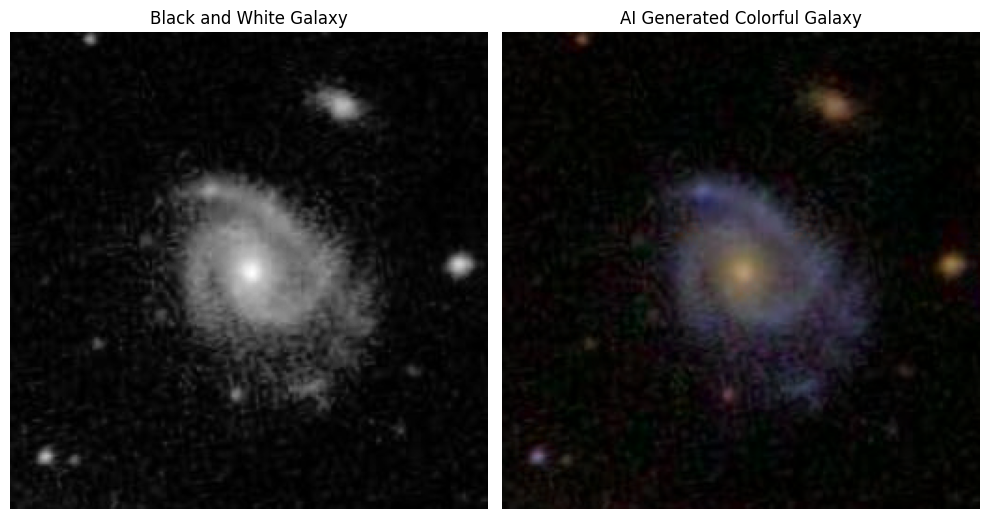

In [181]:
# Choose a random image path from the testing image directory
img_test_path = np.random.choice(val_paths)

# Open and convert the image to RGB format
img = Image.open(img_test_path).convert("RGB")

# Crop the image to the specified size
img = transforms.Compose([transforms.CenterCrop(SIZE)])(img)

# Convert the image to a NumPy array
img = np.array(img)

# Convert the RGB image to L*a*b color space
img_lab = rgb2lab(img).astype("float32")

# Convert the image to a PyTorch tensor
img_lab = transforms.ToTensor()(img_lab)

# Normalize the L channel (luminance) to be between -1 and 1
L = img_lab[[0], ...] / 50. - 1.

# Add the batch dimension to the L tensor
L = L.unsqueeze(0)

# Load the pre-trained model weight for generator and set it to evaluation mode
generator = Unet(input_c=1, output_c=2, n_down=8, num_filters=64)
generator.load_state_dict(torch.load('/kaggle/working/Generator Checkpoints/generator_epoch_17.pth'))
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
generator.to(device)
generator.eval()

# Get ab output by passing L to generator model and removes it from the computation graph to prevent further gradient calculations
ab = generator(L.to(device))
ab = ab.detach()

# Convert the L and ab channels back to RGB color space
rgb_out = lab_to_rgb(L.to(device), ab.to(device))

# Visualize side by side BW and Colorful Image
plt.figure(figsize=(10, 10))

# BW Galaxy Image
plt.subplot(121)
plt.imshow(L[0].permute(1, 2, 0), cmap='gray')
plt.title('Black and White Galaxy')
plt.axis('off')

# Colorful Galaxy Image by AI
plt.subplot(122)
plt.title('AI Generated Colorful Galaxy')
plt.imshow(rgb_out[0])
plt.axis('off')

# Adjust the layout
plt.tight_layout()
plt.show()

* You can surely train for more epochs and fine tune the model further to get even better results!
* You can change batchnorm to instance norm
* You can try to keep batch size of 1 as recommended in the original paper
* Also you can make the changes in the UNET as explained in that part (dropouts fix)

## 16. Download the Test Zip File to use it while building the API 
* Go to the data page
* Download the zip file for test images
* Download the generator weights from the Best EPOCH

--- 

# <center> THE END